In [1]:
import math
import xarray as xr
import cartopy.crs as ccrs
import matplotlib as mpl
from matplotlib import pyplot as plt 
import matplotlib.pylab as plt
import matplotlib.path as mpath
from matplotlib.pyplot import figure
import numpy as np
import cartopy.feature as cfeature
from matplotlib.cm import get_cmap
import pyproj
import utm
import pandas as pd 
import traceback 
from pathlib import Path  
import os  
import numpy.ma as ma
import netCDF4 as nc
from netCDF4 import Dataset
import glob
import datetime as dt
import metpy.calc as mpcalc
from metpy.units import units
from metpy.cbook import get_test_data
from metpy.io import metar
from metpy.plots.declarative import (BarbPlot, ContourPlot, FilledContourPlot, MapPanel,
                                     PanelContainer, PlotObs)
from netCDF4 import date2num,num2date
#from scipy.ndimage import gaussian_filter
import wrf
from wrf import (getvar, interplevel, to_np, latlon_coords, get_cartopy,
                 cartopy_xlim, cartopy_ylim)
from wrf import getvar, interplevel, to_np, get_basemap, latlon_coords

In [2]:
D2_0 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_00_00_00')
D2_1 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_01_00_00')
D2_2 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_02_00_00')
D2_3 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_03_00_00')
D2_4 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_04_00_00')
D2_5 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_05_00_00')
D2_6 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_06_00_00')
D2_7 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_07_00_00')
D2_8 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_08_00_00')
D2_9 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_09_00_00')
D2_10 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_10_00_00')
D2_11 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_11_00_00')
D2_12 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_12_00_00')
D2_13 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_13_00_00')
D2_14 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_14_00_00')
D2_15 =  xr.open_dataset('/Users/Anna/Desktop/WRF/D2_D1_Only/wrfout_d02_2018-03-25_15_00_00')

In [4]:
lat0 =D2_0.XLAT.values
lon0 = D2_0.XLONG.values
w_0 = D2_0.W.values
poT_0 = D2_0.T.values
print(lat0.shape)
print(lon0.shape)
print(w_0.shape)
print(poT_0.shape)

lat1 =D2_1.XLAT.values
lon1 = D2_1.XLONG.values
w_1 = D2_1.W.values
poT_1 = D2_1.T.values

lat2 =D2_2.XLAT.values
lon2 = D2_2.XLONG.values
w_2 = D2_2.W.values
poT_2 = D2_2.T.values

lat3 =D2_3.XLAT.values
lon3 = D2_3.XLONG.values
w_3 = D2_3.W.values
poT_3 = D2_3.T.values

lat4 =D2_4.XLAT.values
lon4 = D2_4.XLONG.values
w_4 = D2_4.W.values
poT_4 = D2_4.T.values

lat5 =D2_5.XLAT.values
lon5 = D2_5.XLONG.values
w_5 = D2_5.W.values
poT_5 = D2_5.T.values

lat6 =D2_6.XLAT.values
lon6 = D2_6.XLONG.values
w_6 = D2_6.W.values
poT_6 = D2_6.T.values

lat7 =D2_7.XLAT.values
lon7 = D2_7.XLONG.values
w_7 = D2_7.W.values
poT_7 = D2_7.T.values

lat8 =D2_8.XLAT.values
lon8 = D2_8.XLONG.values
w_8 = D2_8.W.values
poT_8 = D2_8.T.values

lat9 =D2_9.XLAT.values
lon9 = D2_9.XLONG.values
w_9 = D2_9.W.values
poT_9 = D2_9.T.values

lat10 =D2_10.XLAT.values
lon10 = D2_10.XLONG.values
w_10 = D2_10.W.values
poT_10 = D2_10.T.values

lat11 =D2_11.XLAT.values
lon11 = D2_11.XLONG.values
w_11 = D2_11.W.values
poT_11 = D2_11.T.values

lat12 =D2_12.XLAT.values
lon12 = D2_12.XLONG.values
w_12 = D2_12.W.values
poT_12 = D2_12.T.values

lat13 =D2_13.XLAT.values
lon13 = D2_13.XLONG.values
w_13 = D2_13.W.values
poT_13 = D2_13.T.values

lat14 =D2_14.XLAT.values
lon14 = D2_14.XLONG.values
w_14 = D2_14.W.values
poT_14 = D2_14.T.values

lat15=D2_15.XLAT.values
lon15 = D2_15.XLONG.values
w_15 = D2_15.W.values
poT_15 = D2_15.T.values

(1, 486, 651)
(1, 486, 651)
(1, 50, 486, 651)
(1, 49, 486, 651)


C:\Users\Anna\anaconda3\envs\metpy\lib\site-packages\cartopy\mpl\gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


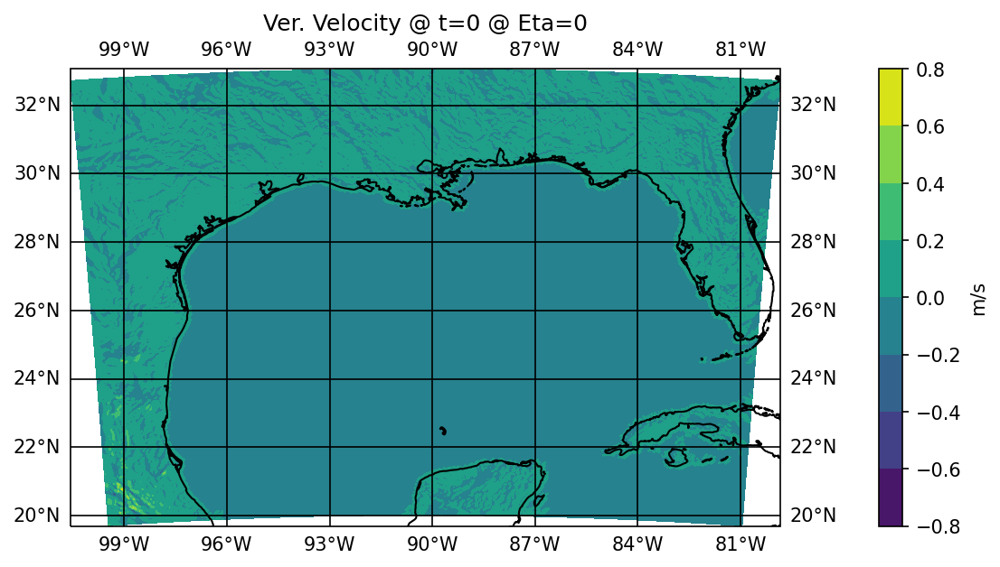

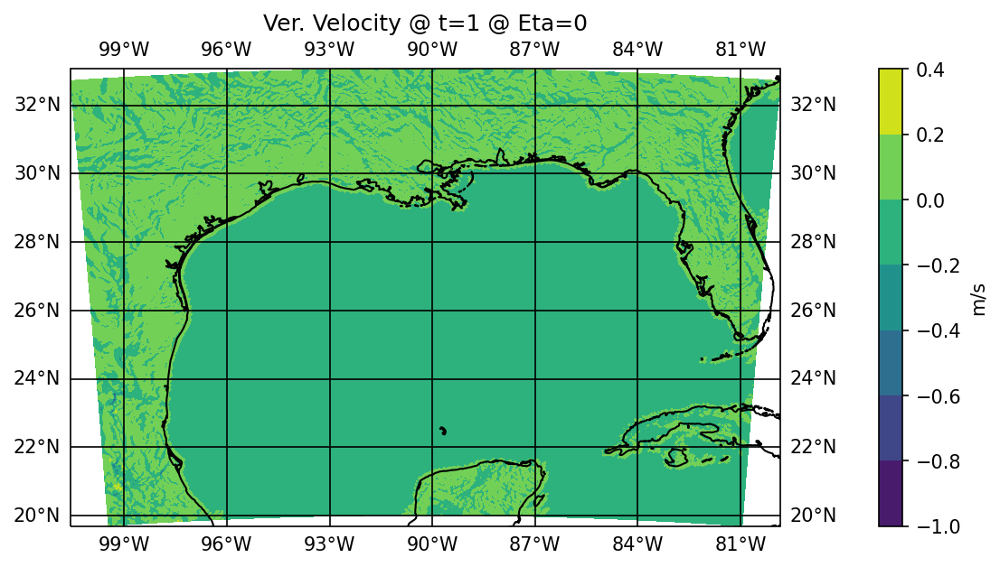

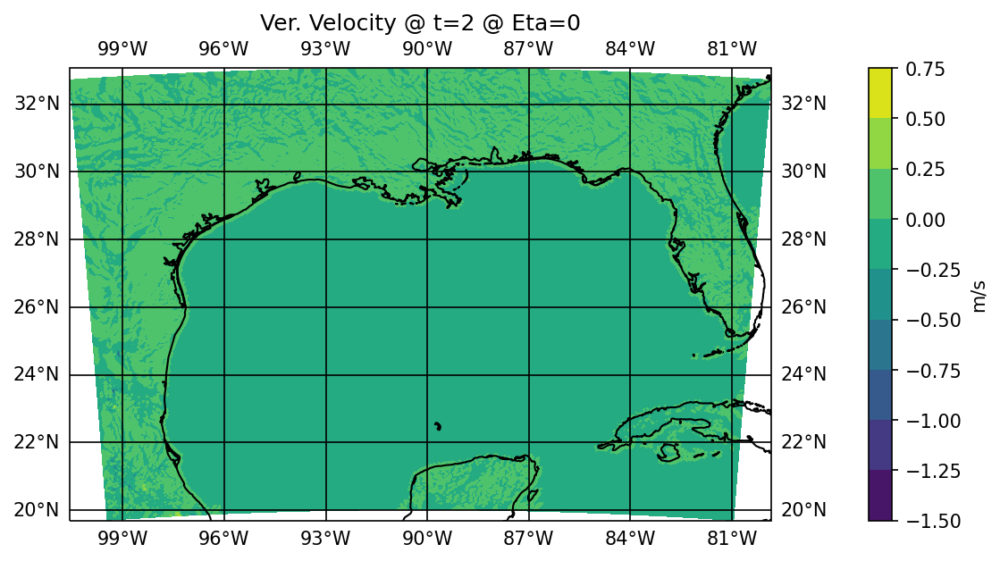

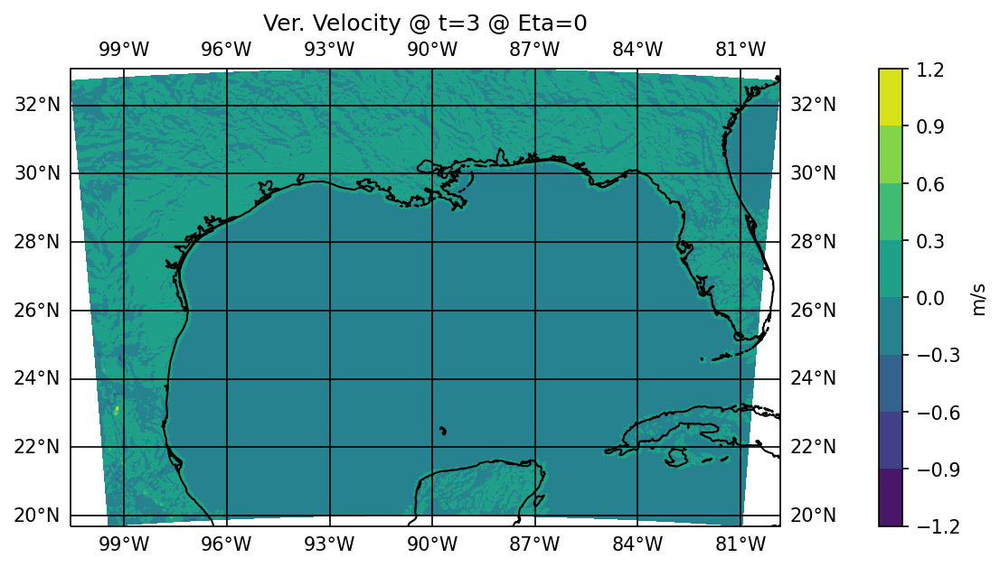

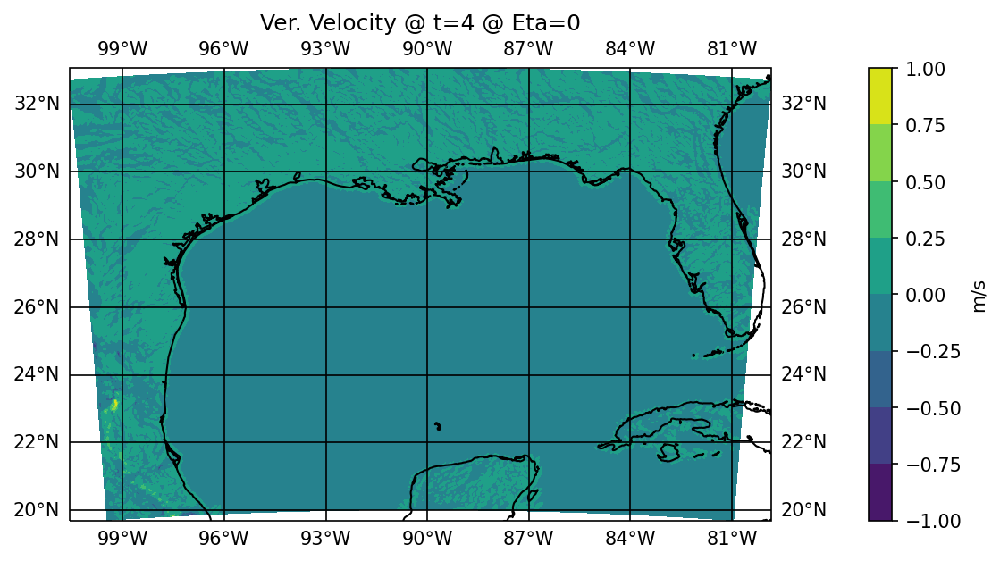

...

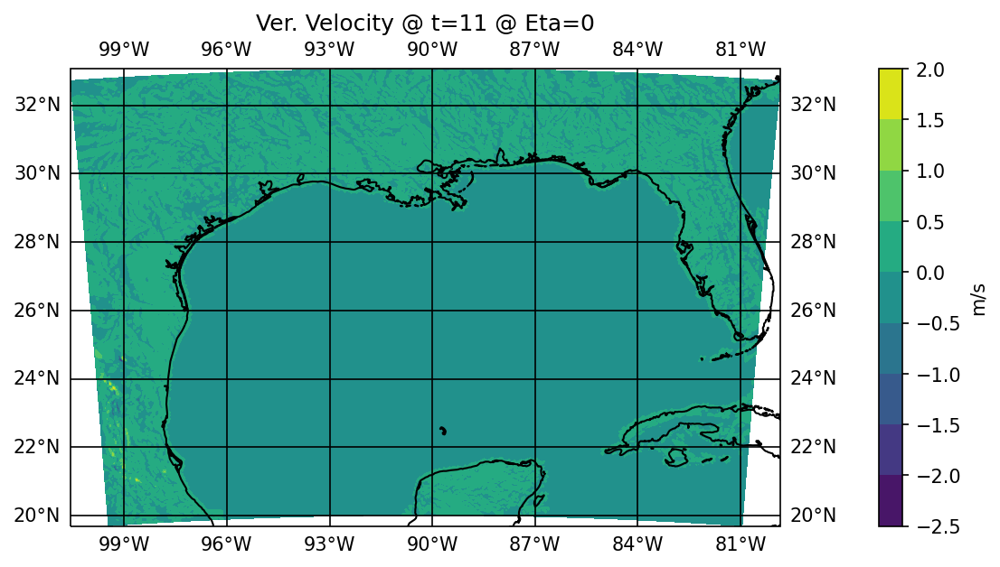

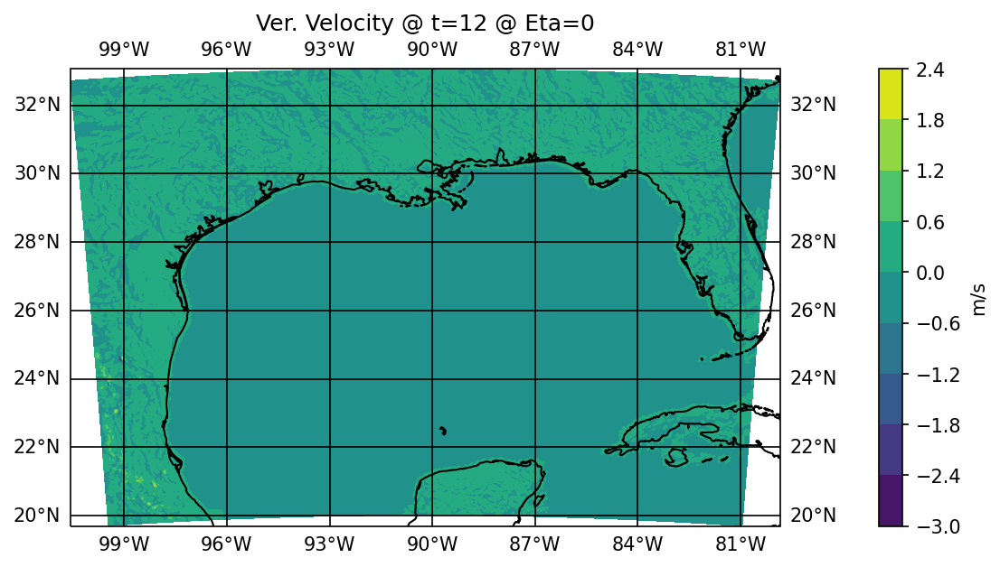

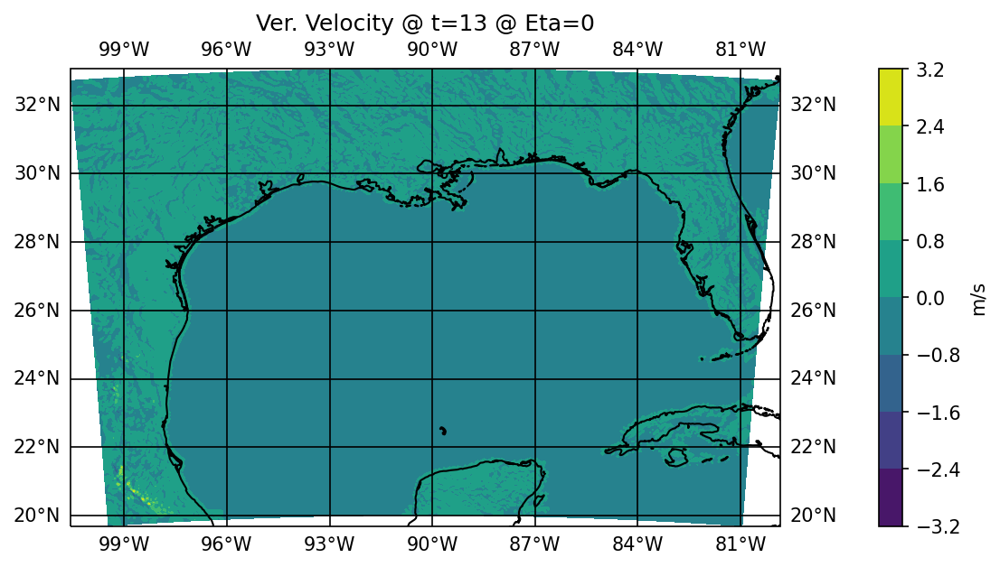

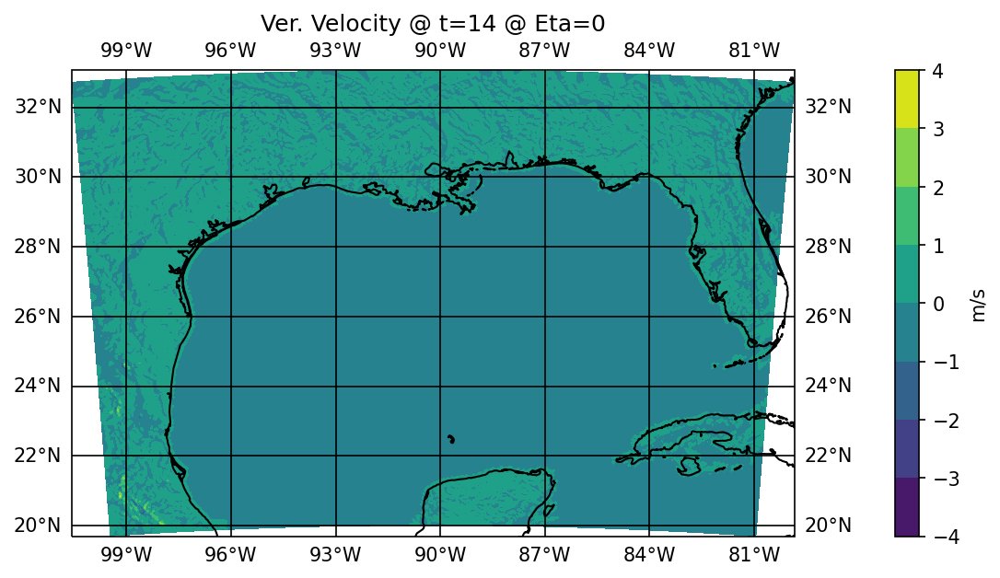

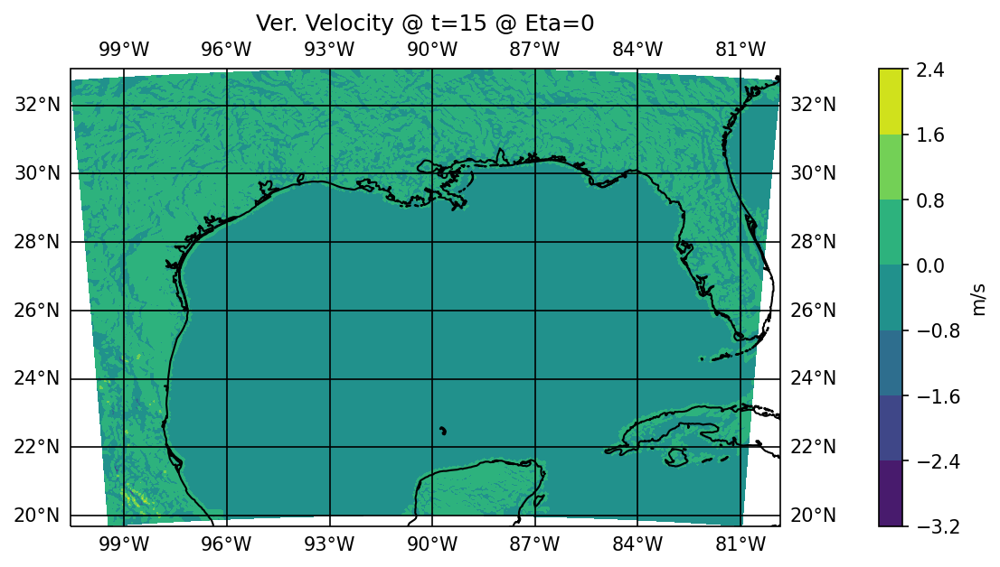

In [4]:
#Eta0
mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], w_0[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=0 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], w_1[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=1 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], w_2[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=2 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], w_3[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=3 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], w_4[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=4 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], w_5[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=5 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], w_6[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=6 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], w_7[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=7 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], w_8[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=8 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], w_9[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=9 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], w_10[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=10 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time10.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], w_11[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=11 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], w_12[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=12 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], w_13[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=13 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], w_14[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=14 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], w_15[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=15 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta0_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()

C:\Users\Anna\anaconda3\envs\metpy\lib\site-packages\cartopy\mpl\gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


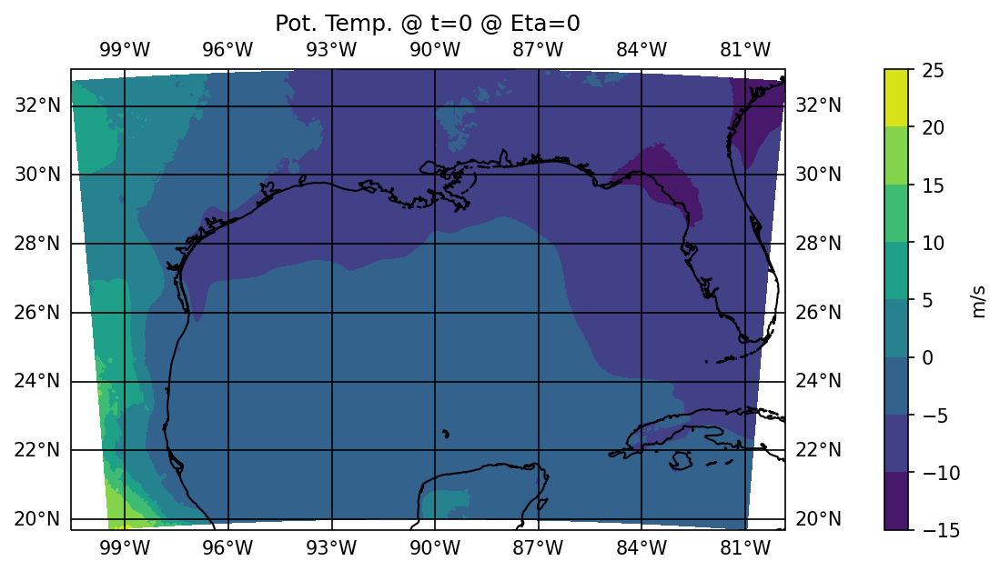

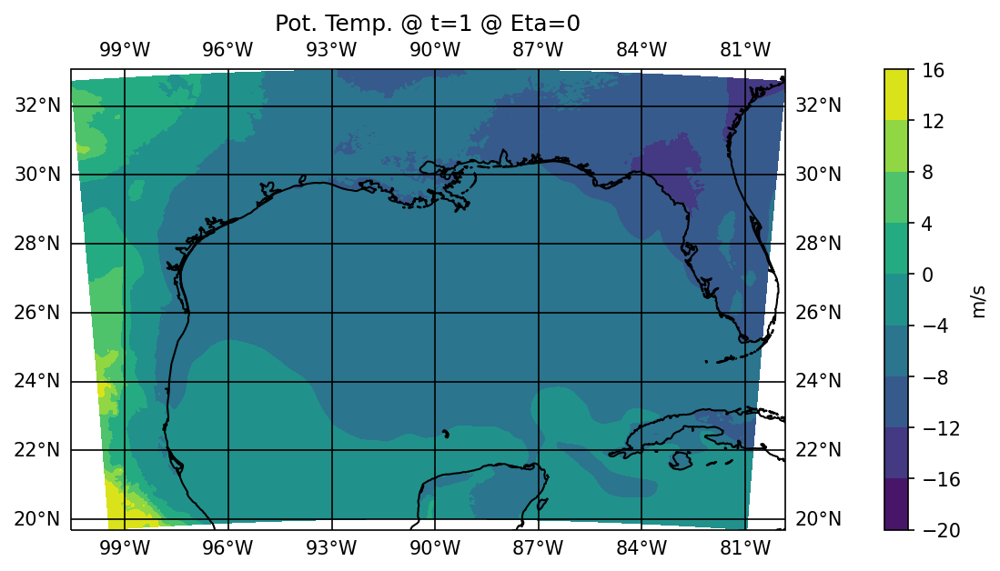

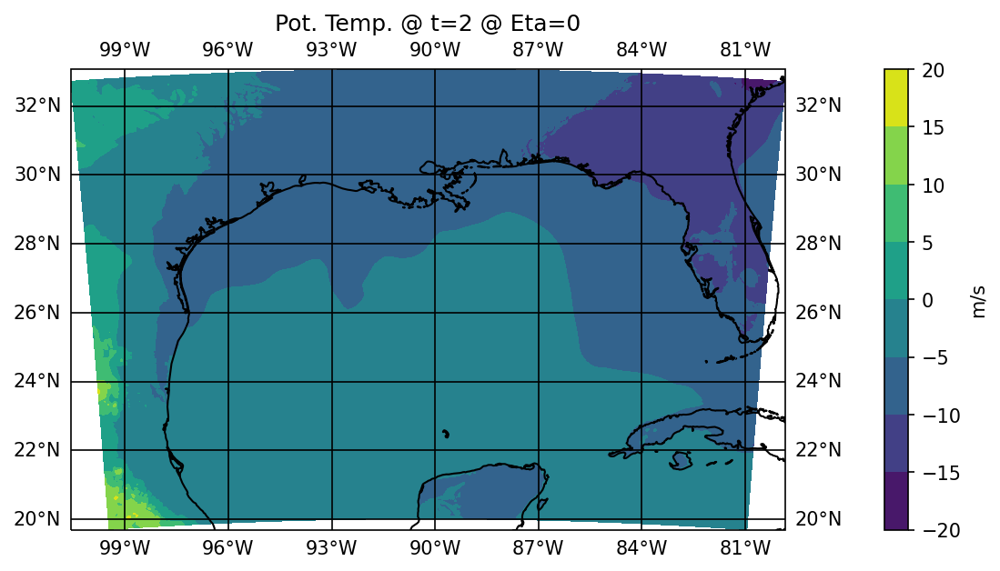

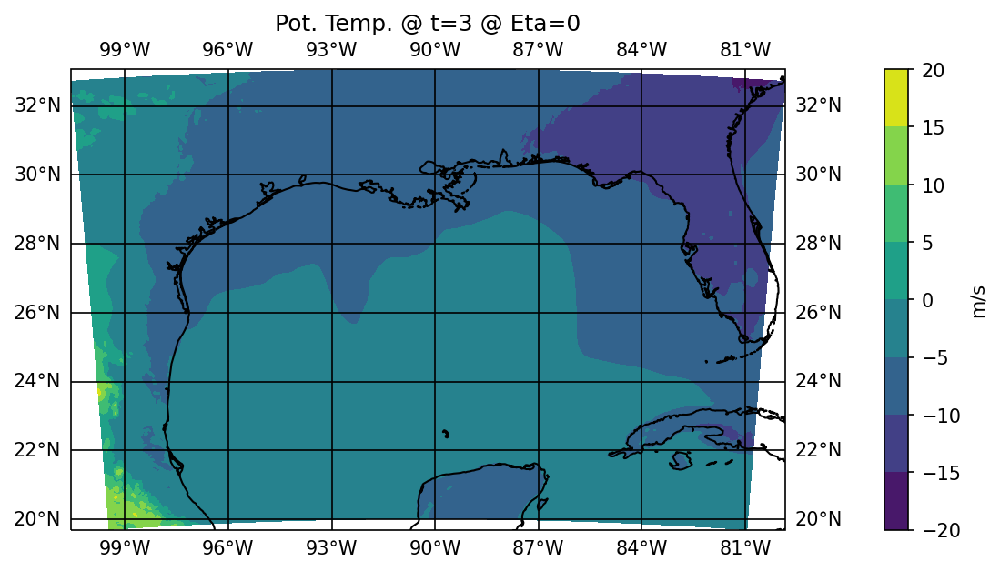

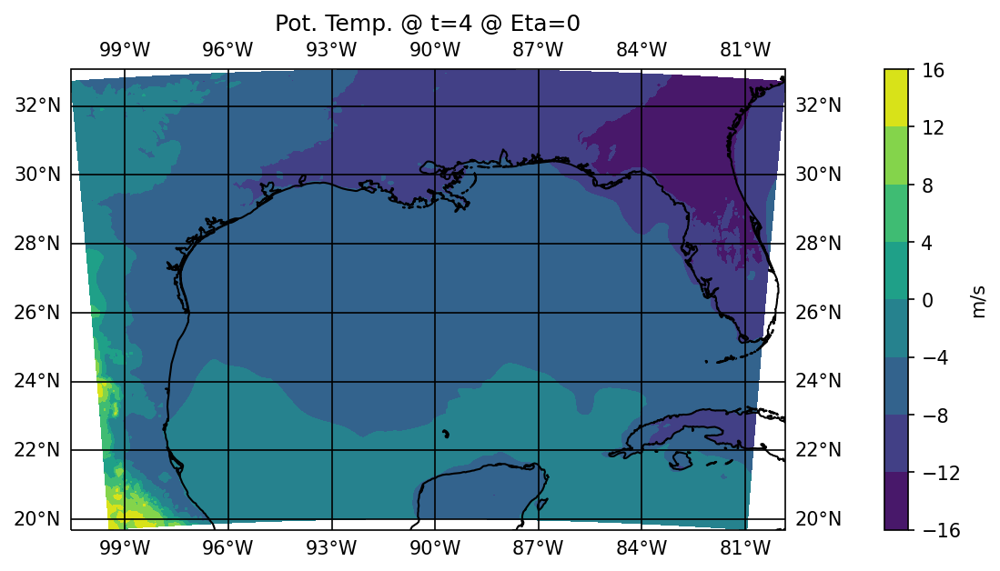

...

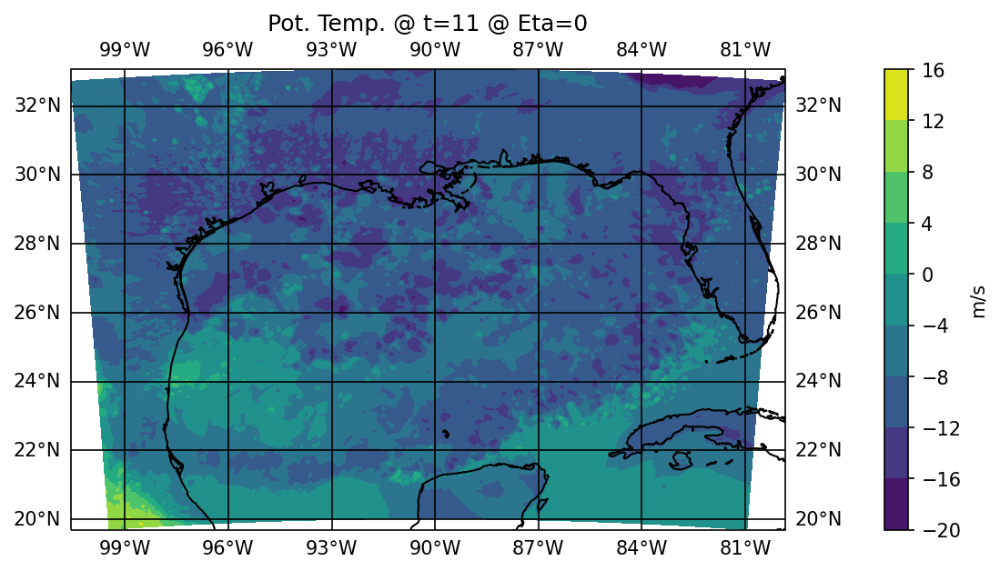

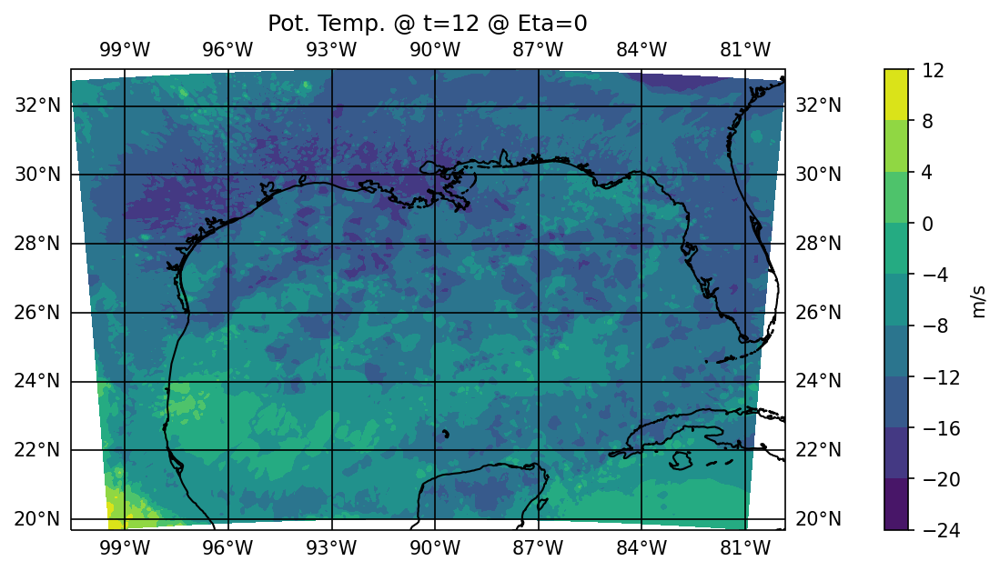

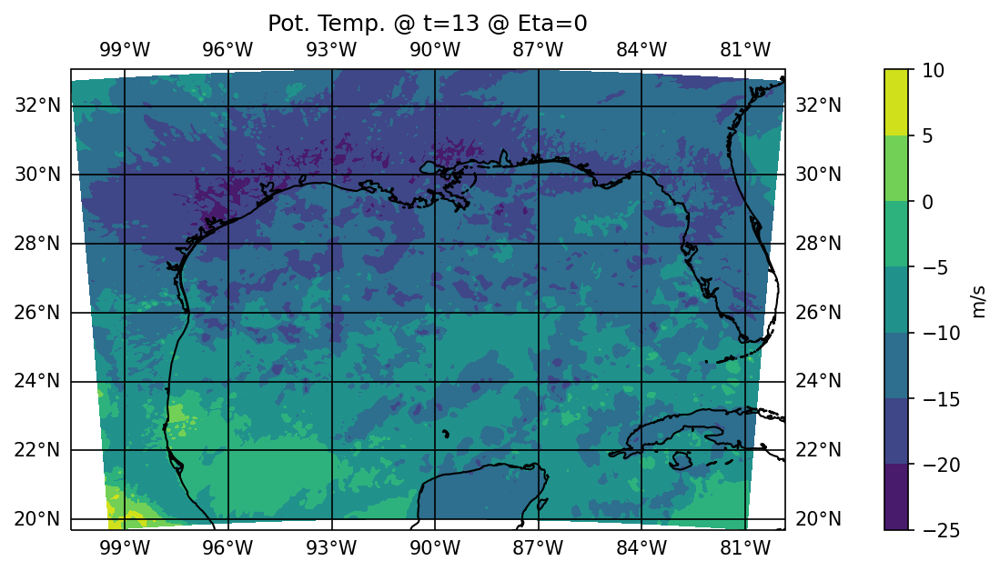

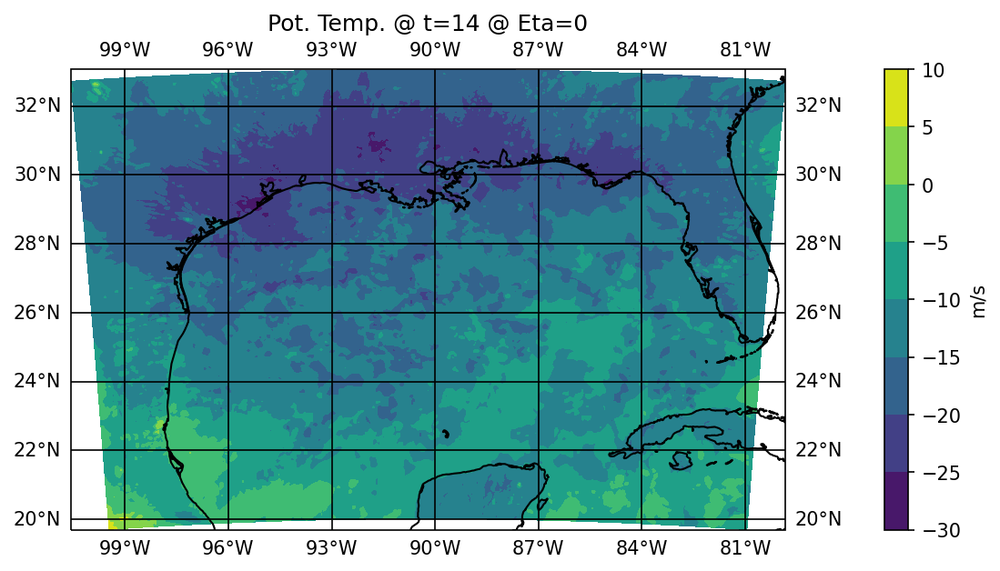

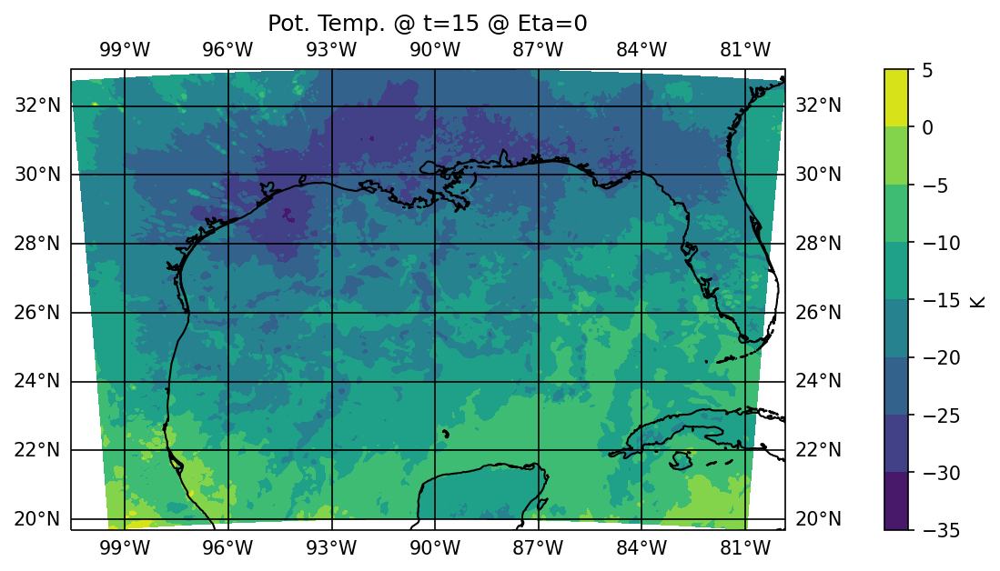

In [5]:
#Eta0
mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], poT_0[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=0 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], poT_1[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=1 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], poT_2[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=2 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], poT_3[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=3 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], poT_4[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=4 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], poT_5[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=5 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], poT_6[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=6 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], poT_7[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=7 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], poT_8[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=8 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], poT_9[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=9 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], poT_10[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=10 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time10.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], poT_11[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=11 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], poT_12[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=12 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], poT_13[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=13 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], poT_14[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=14 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], poT_15[0,0,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'K')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=15 @ Eta=0')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta0_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()

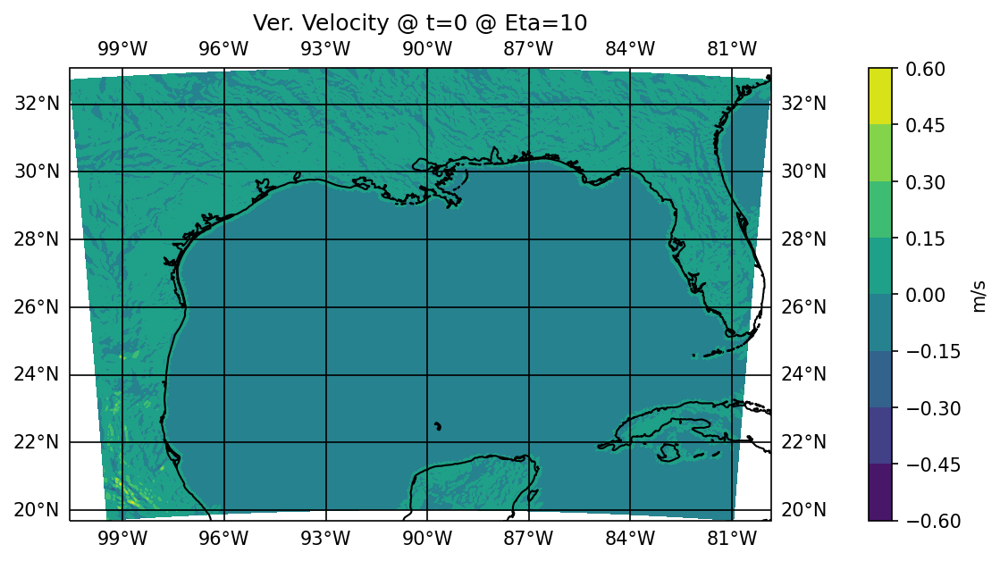

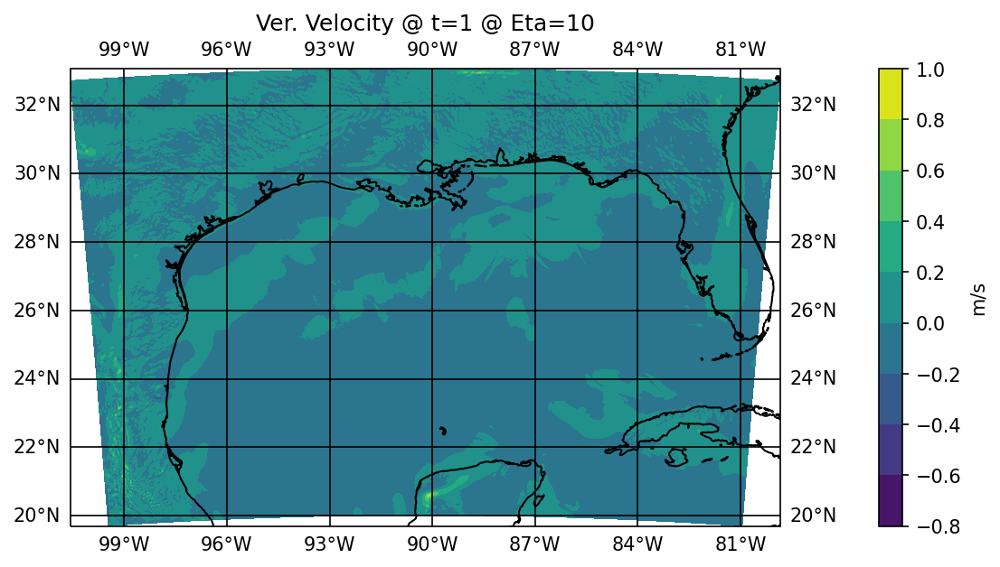

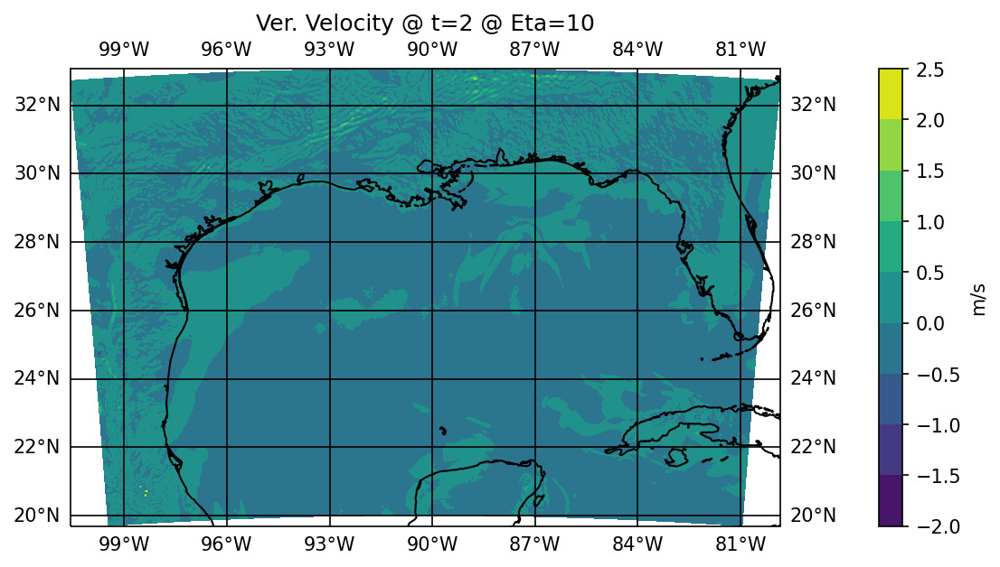

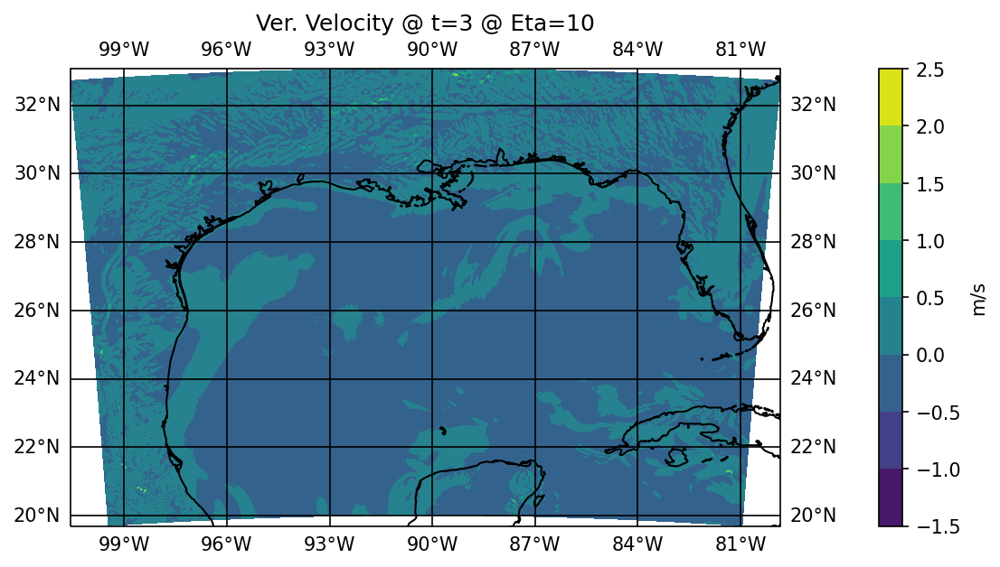

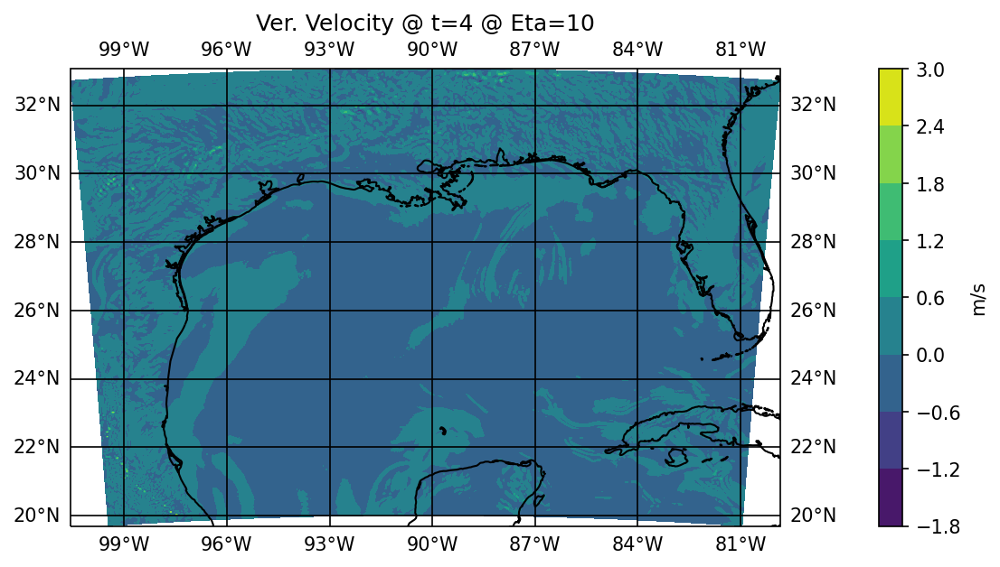

...

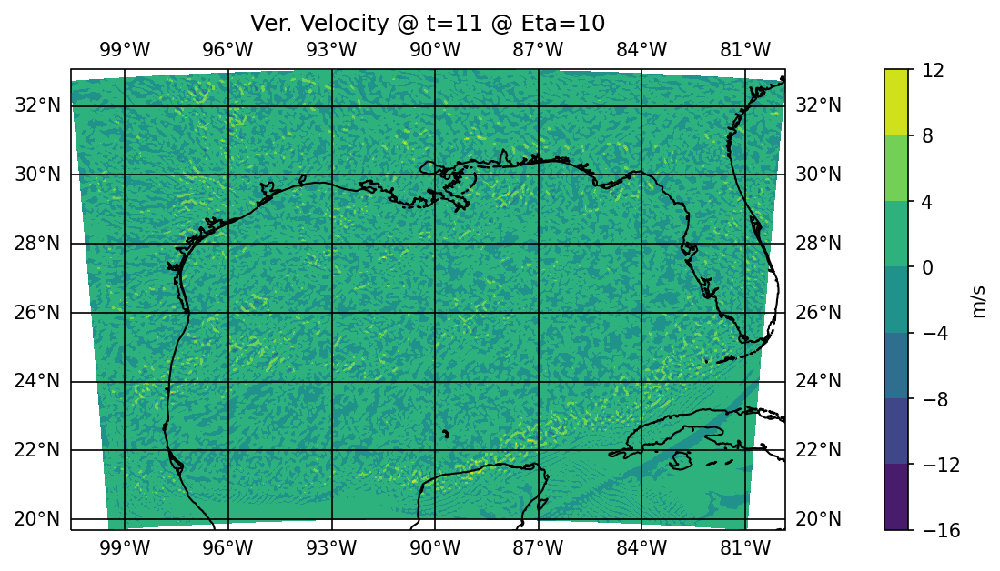

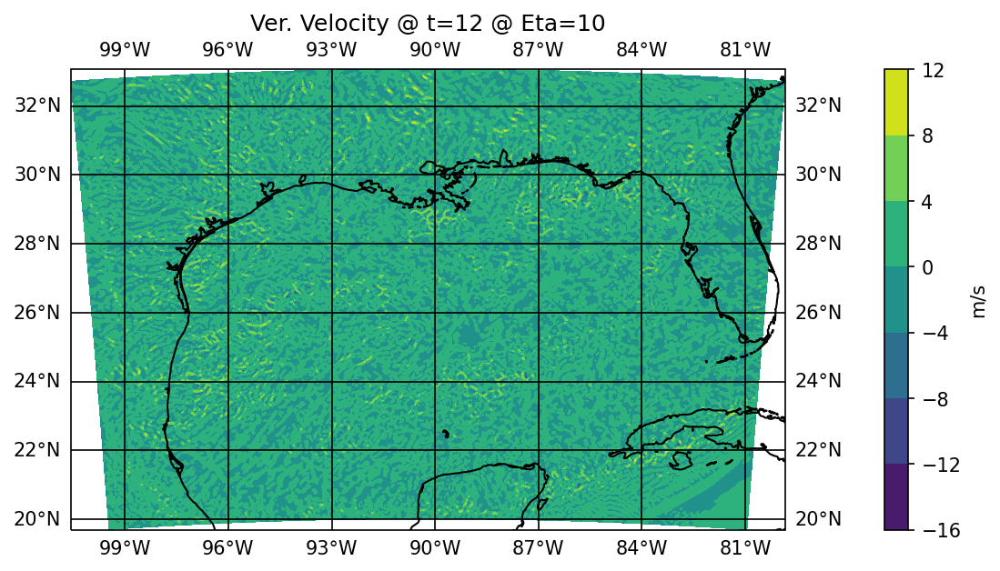

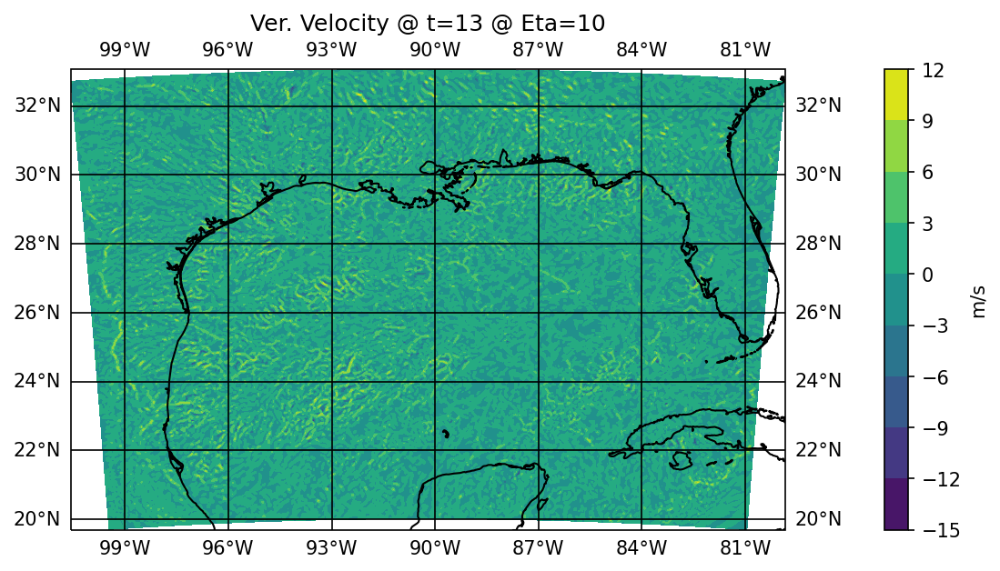

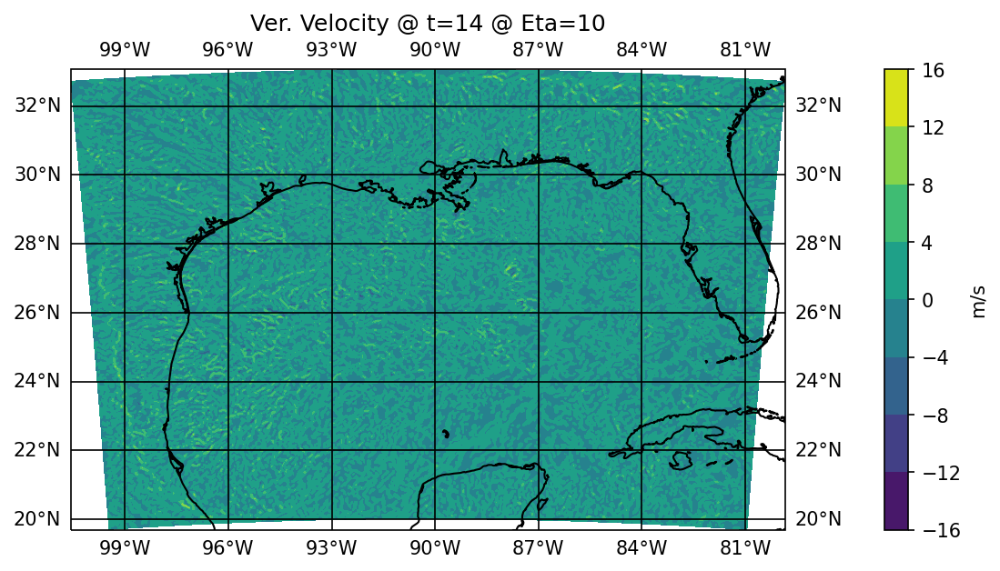

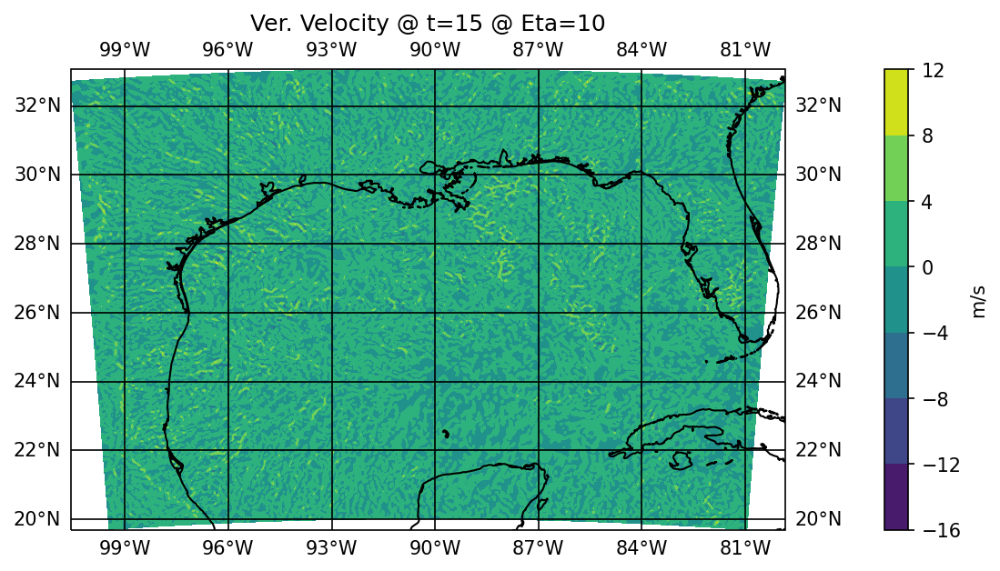

In [6]:
#Eta10
mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], w_0[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=0 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], w_1[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=1 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], w_2[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=2 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], w_3[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=3 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], w_4[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=4 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], w_5[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=5 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], w_6[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=6 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], w_7[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=7 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], w_8[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=8 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], w_9[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=9 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], w_10[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=10 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time10.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], w_11[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=11 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], w_12[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=12 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], w_13[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=13 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], w_14[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=14 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], w_15[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=15 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()

In [ ]:
#Eta10
mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], w_0[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=0 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], w_1[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=1 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], w_2[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=2 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], w_3[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=3 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], w_4[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=4 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], w_5[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=5 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], w_6[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=6 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], w_7[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=7 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], w_8[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=8 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], w_9[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=9 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], w_10[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=10 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time10.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], w_11[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=11 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], w_12[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=12 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], w_13[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=13 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], w_14[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=14 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], w_15[0,10,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=15 @ Eta=10')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()

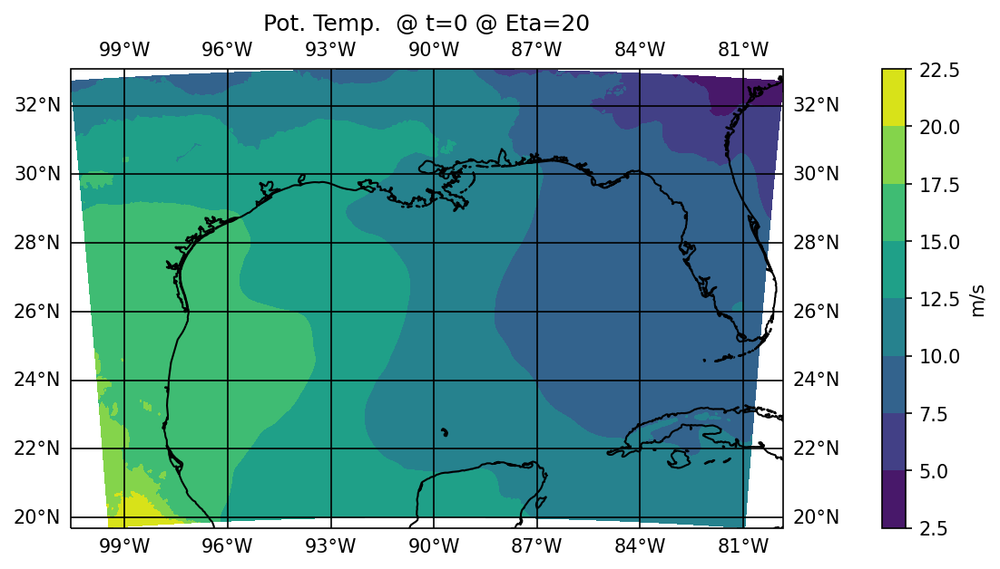

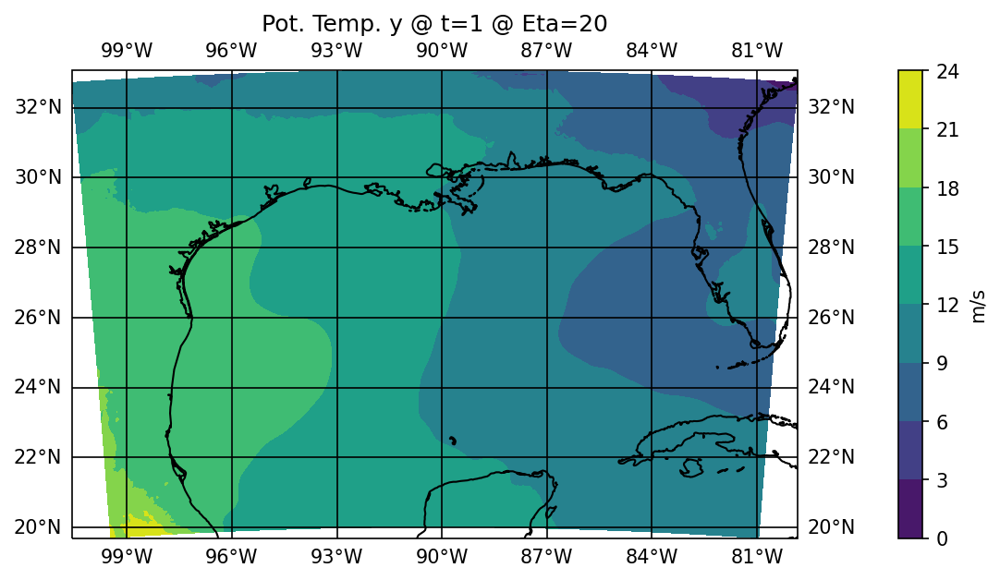

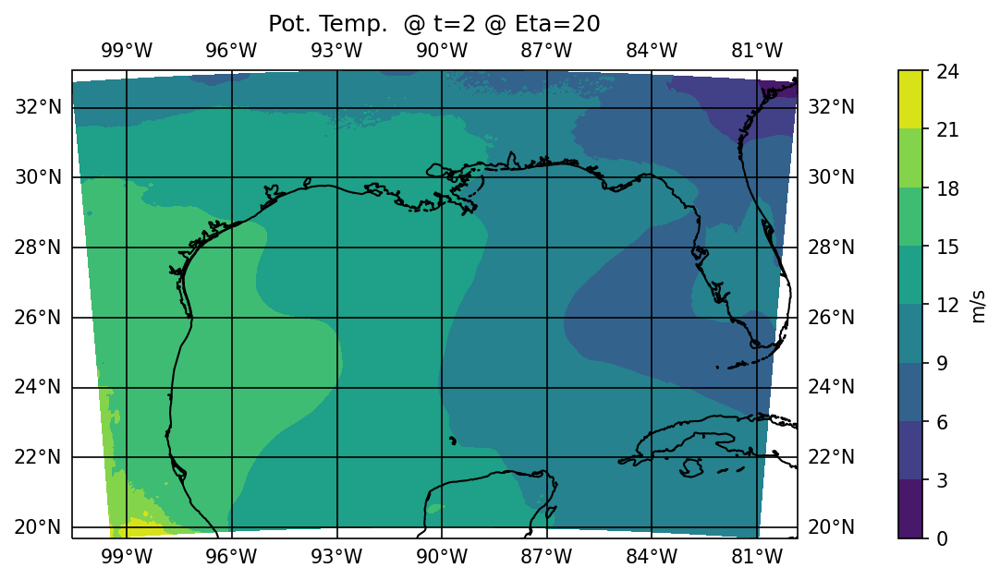

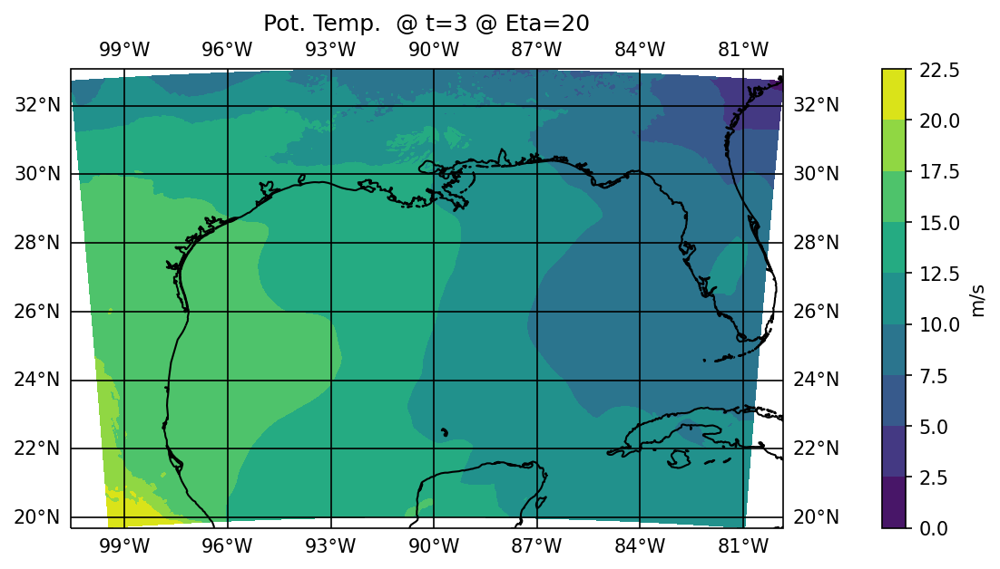

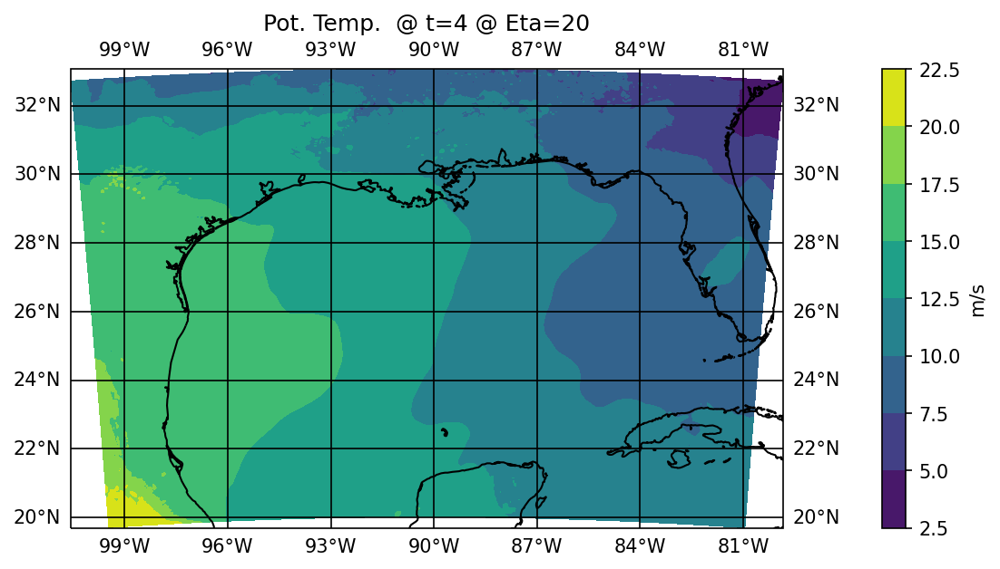

...

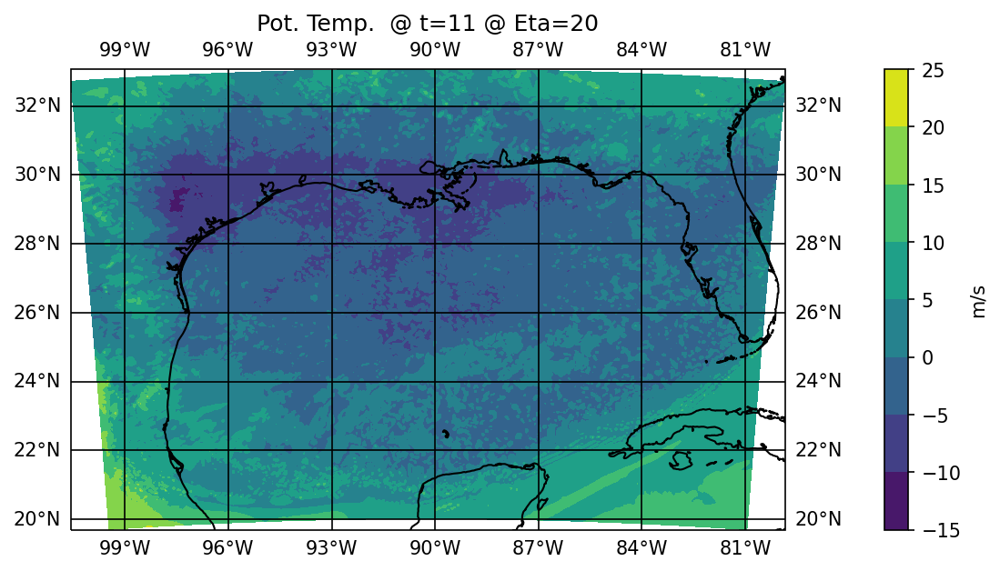

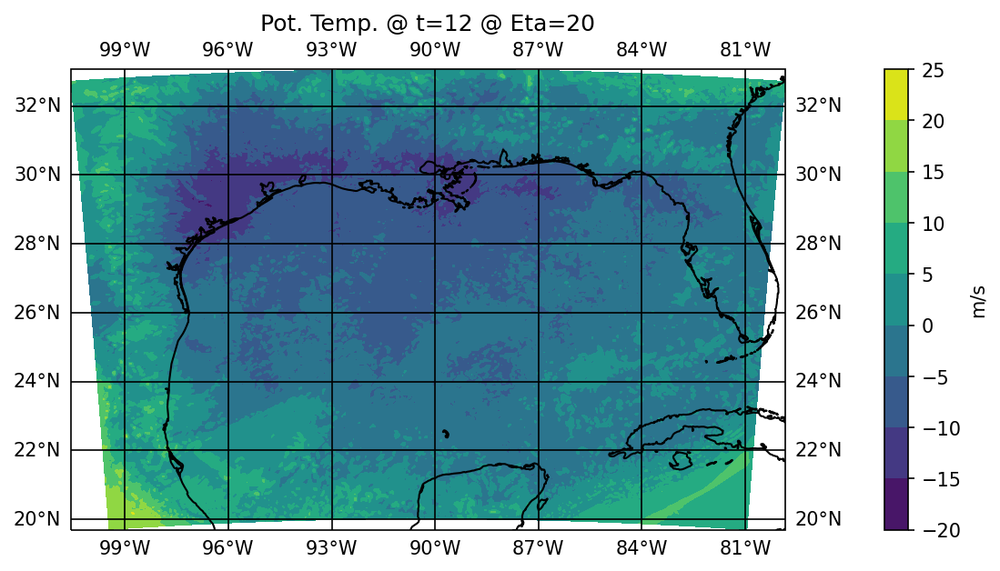

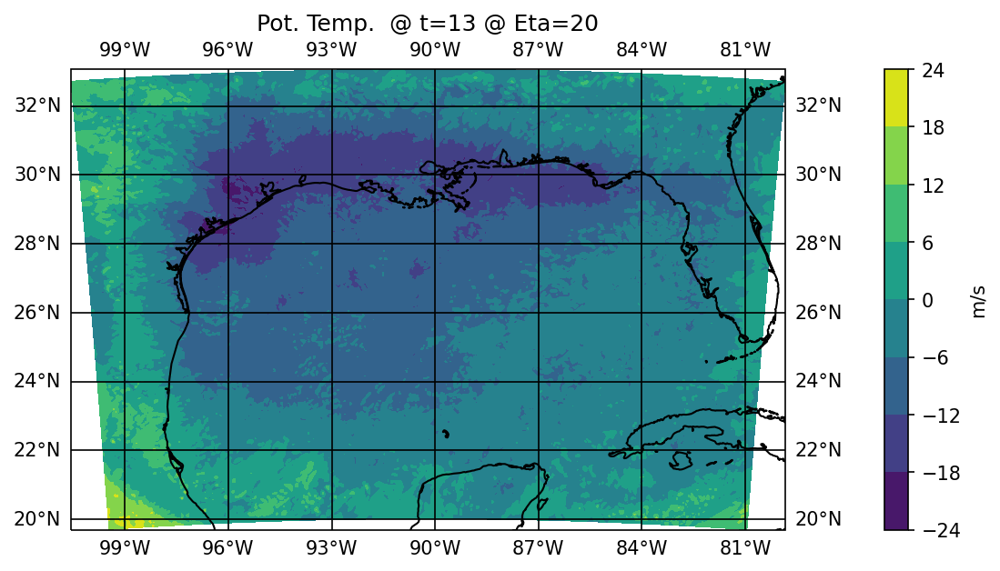

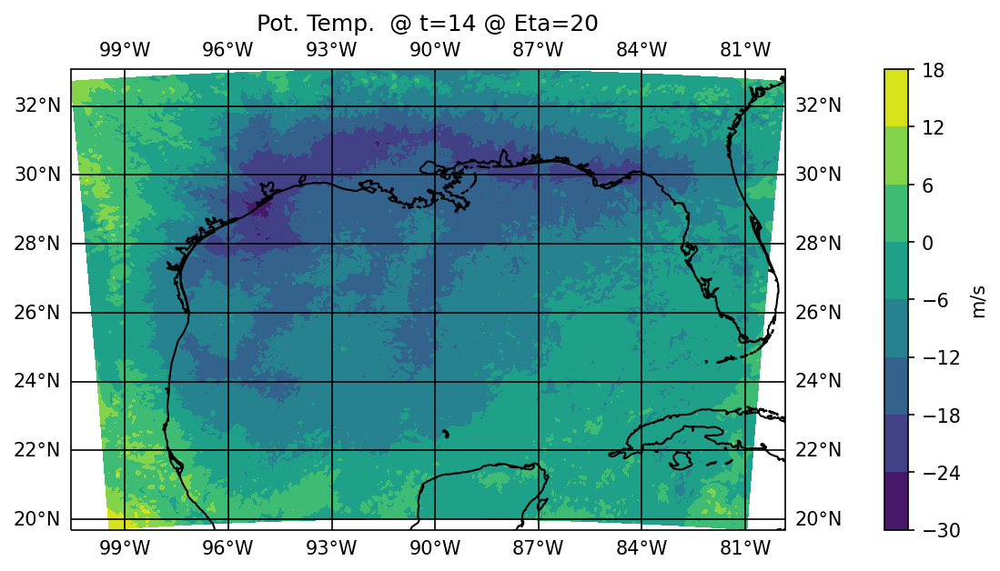

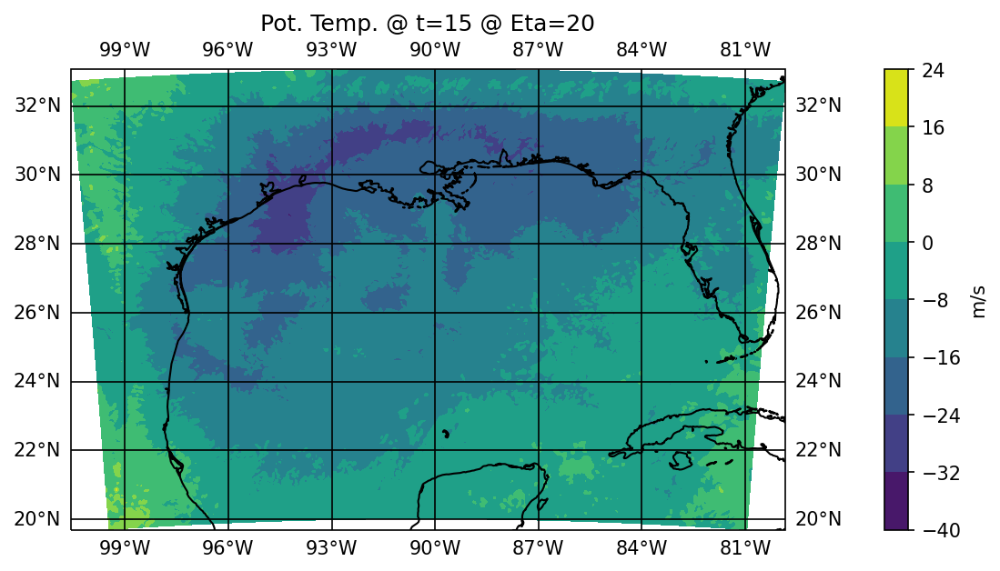

In [6]:
#Eta20
mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], poT_0[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=0 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], poT_1[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. y @ t=1 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], poT_2[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=2 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], poT_3[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=3 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], poT_4[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=4 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], poT_5[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=5 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], poT_6[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=6 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], poT_7[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=7 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], poT_8[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=8 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], poT_9[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=9 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_PoT_eta20_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], poT_10[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=10 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time20.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], poT_11[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=11 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], poT_12[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=12 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], poT_13[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=13 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], poT_14[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.  @ t=14 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], poT_15[0,20,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=15 @ Eta=20')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta20_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()

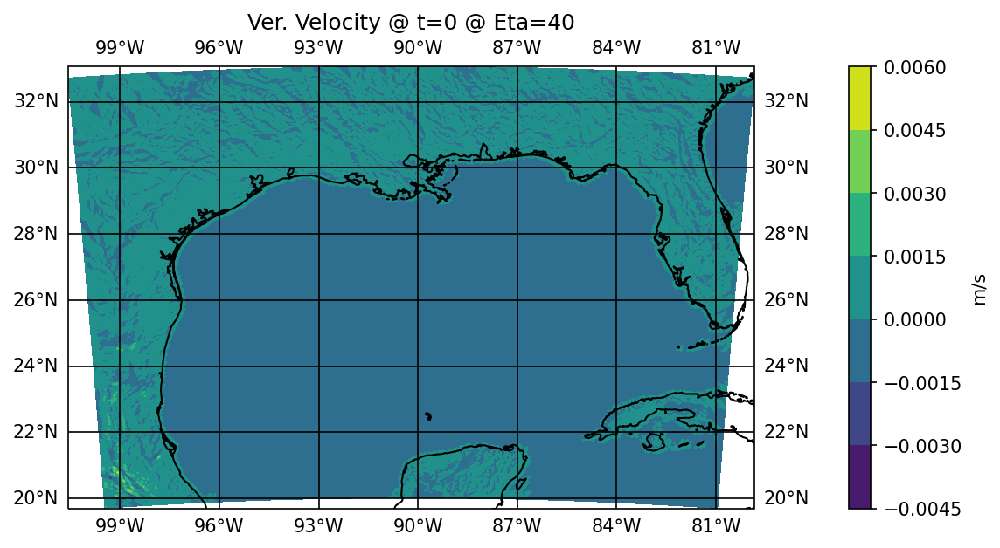

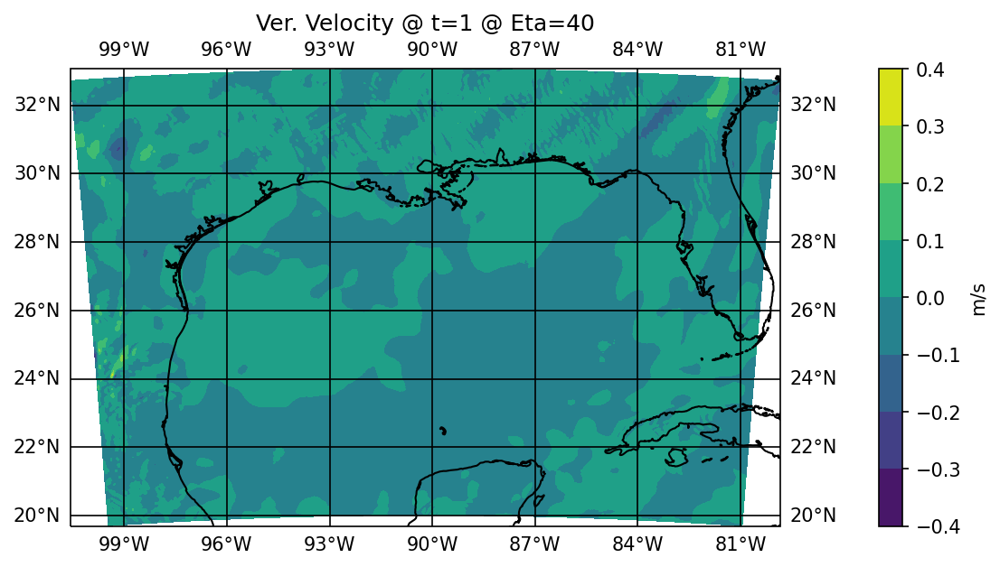

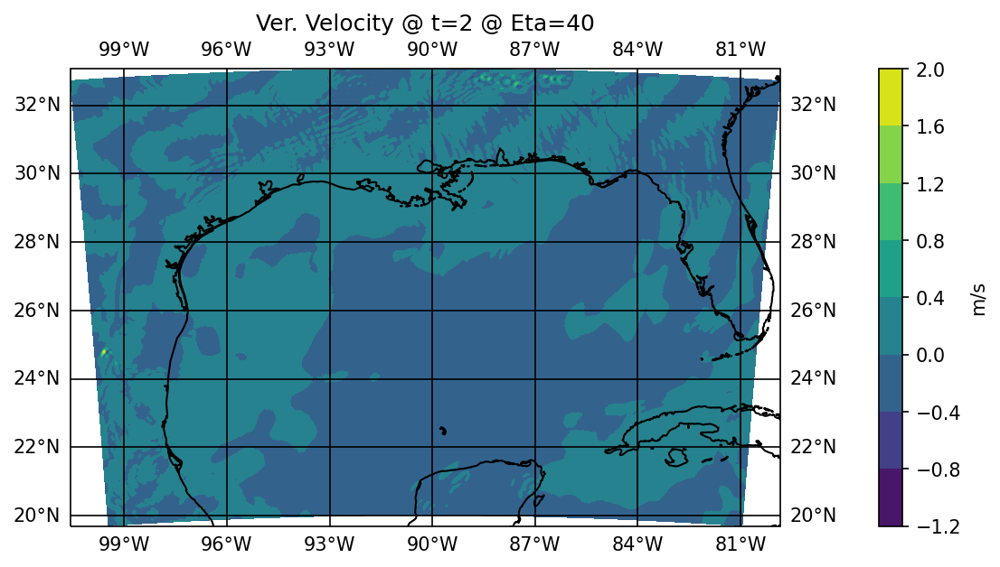

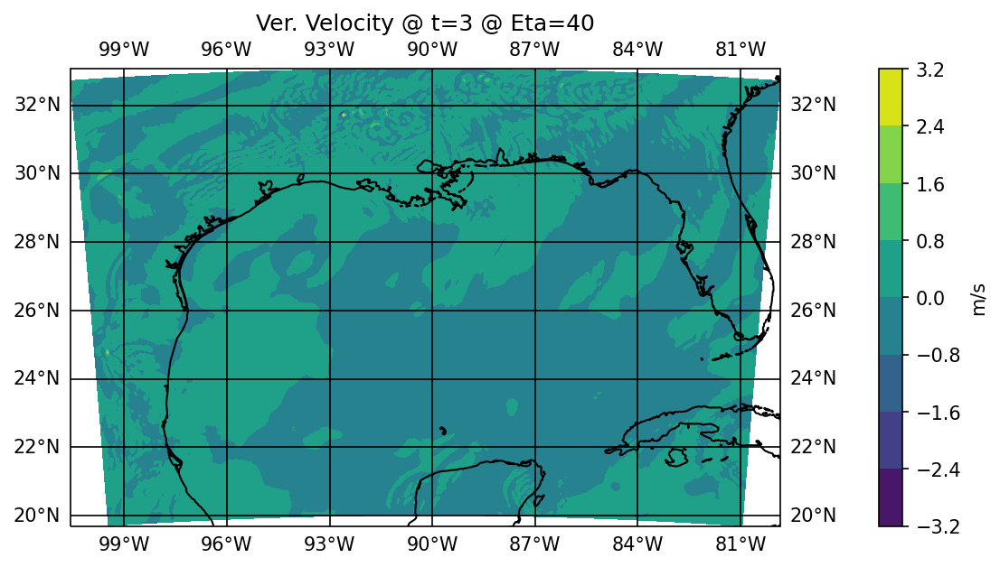

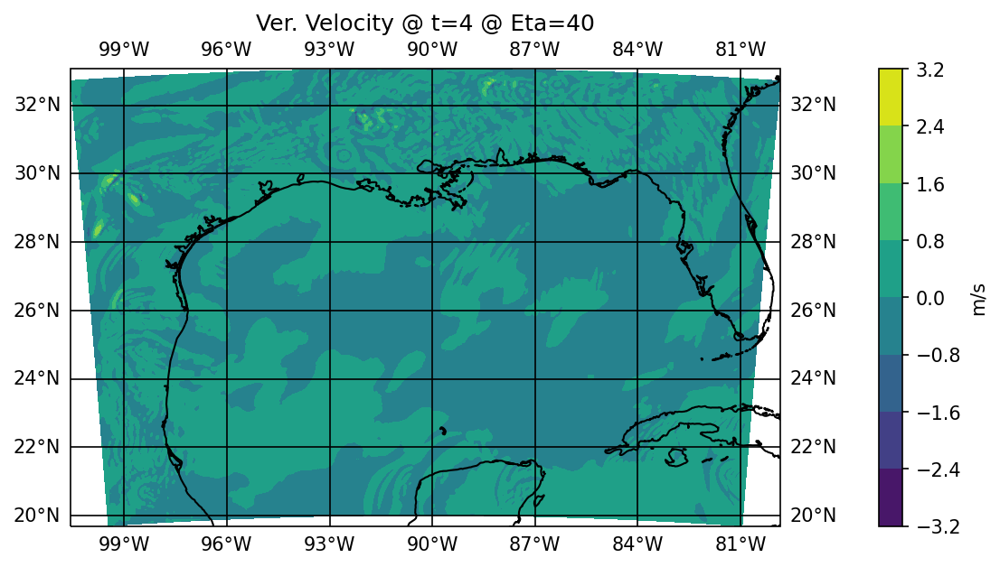

...

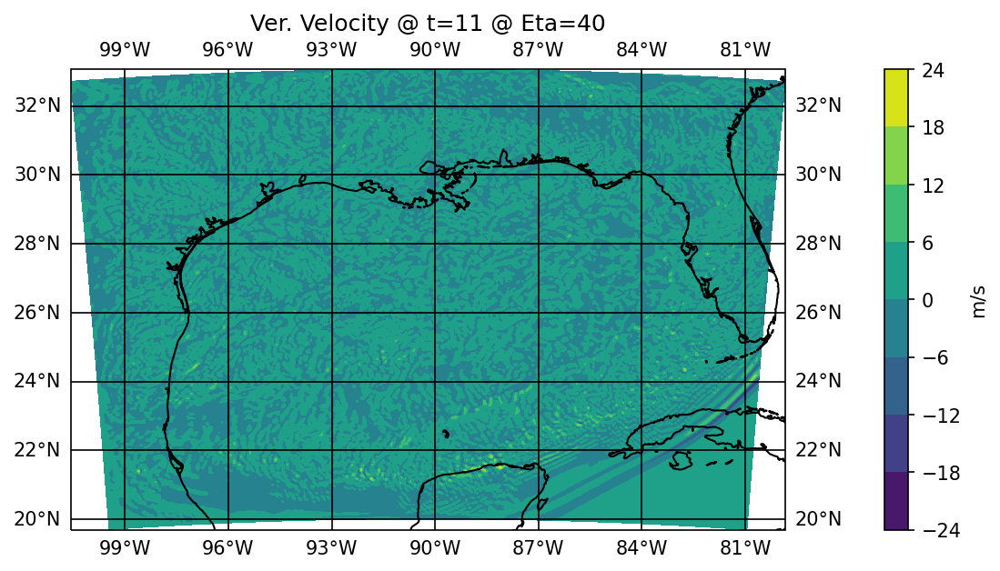

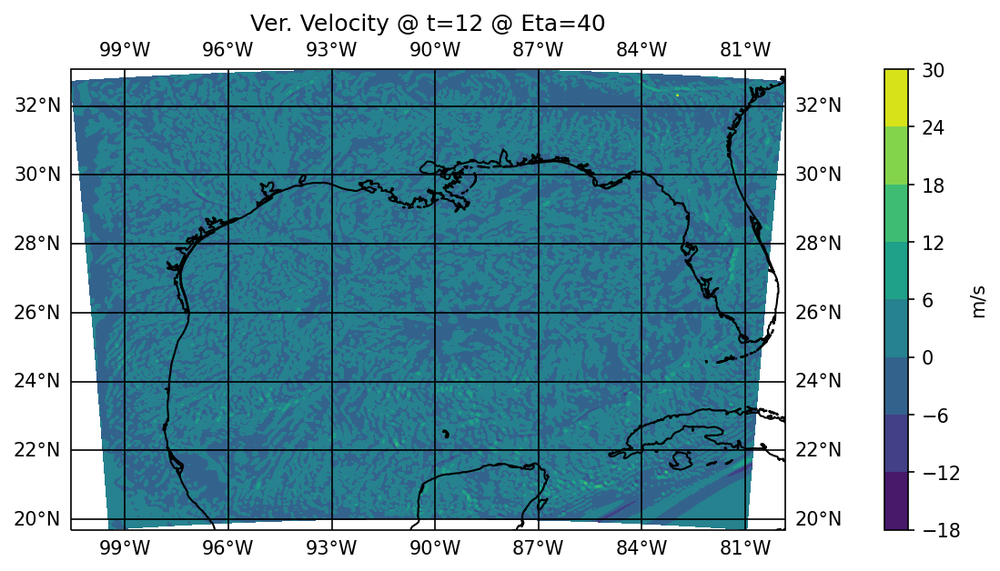

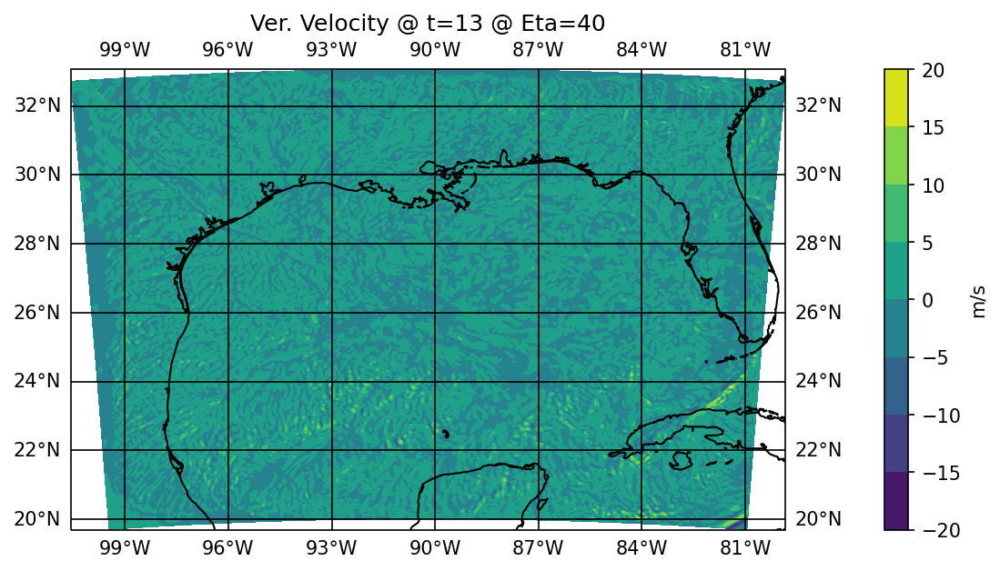

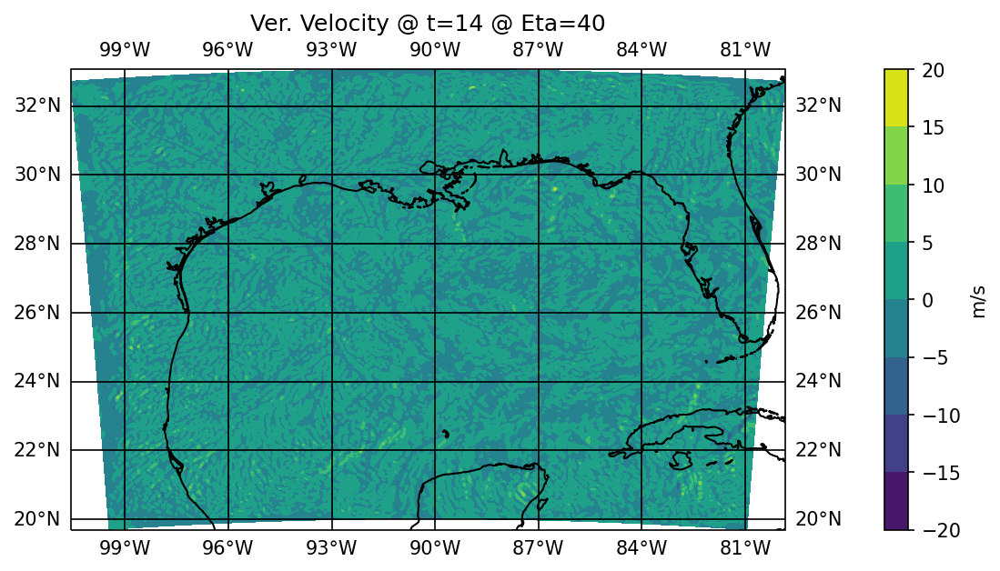

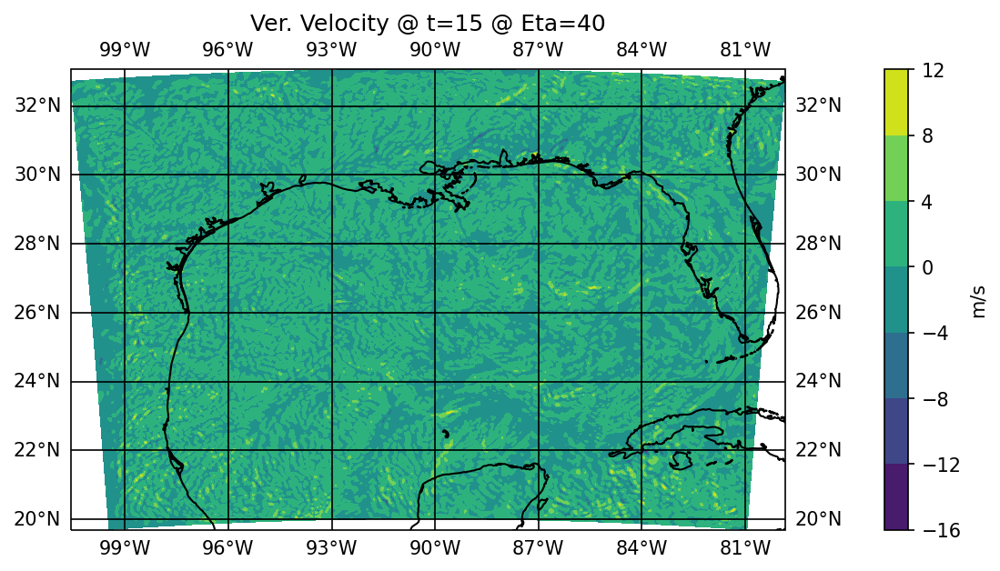

In [10]:
#Eta40
mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], w_0[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=0 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], w_1[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=1 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], w_2[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=2 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], w_3[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=3 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], w_4[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=4 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], w_5[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=5 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], w_6[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=6 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], w_7[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=7 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], w_8[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=8 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], w_9[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=9 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], w_10[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=10 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta10_time40.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], w_11[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=11 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], w_12[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=12 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], w_13[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=13 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], w_14[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=14 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], w_15[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=15 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta40_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()

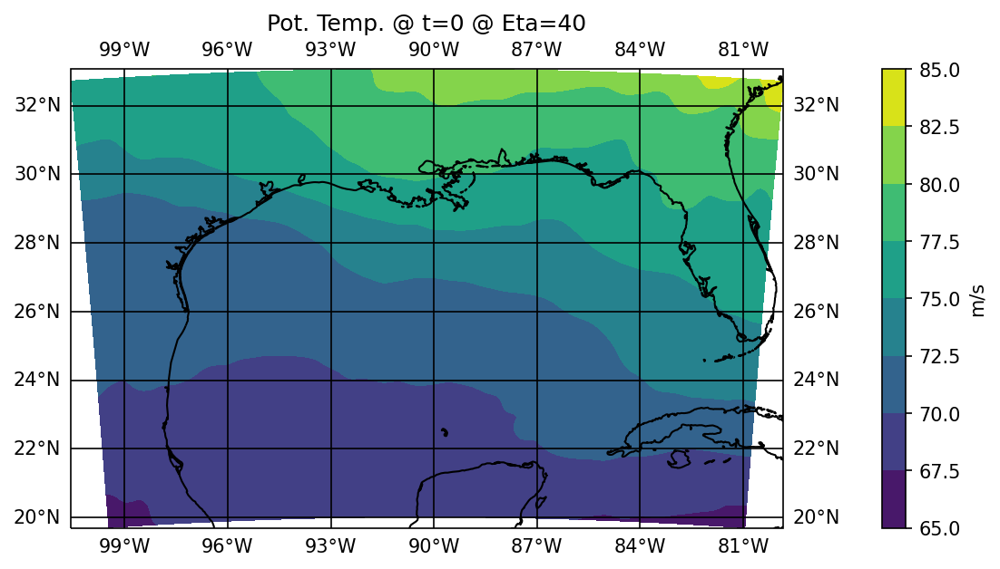

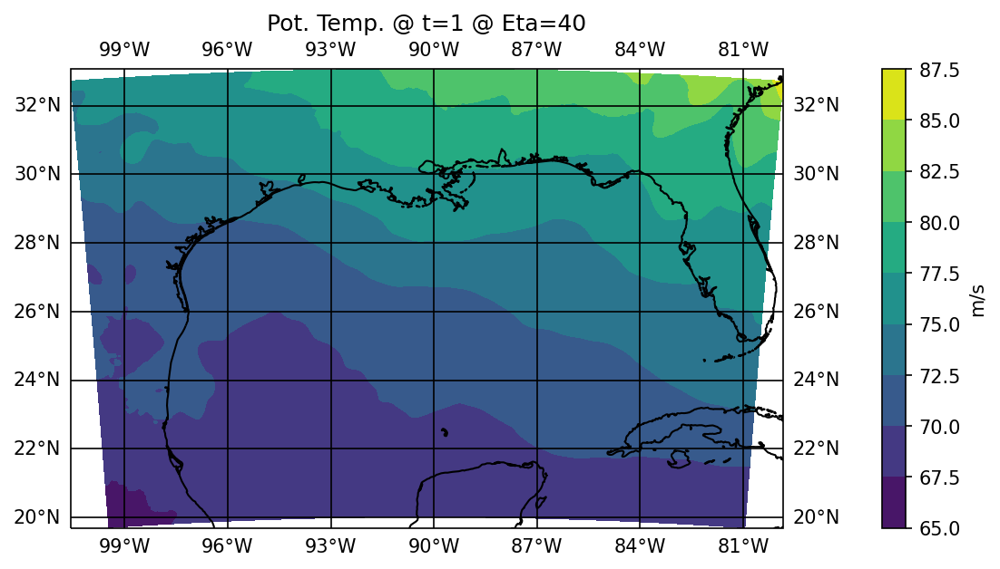

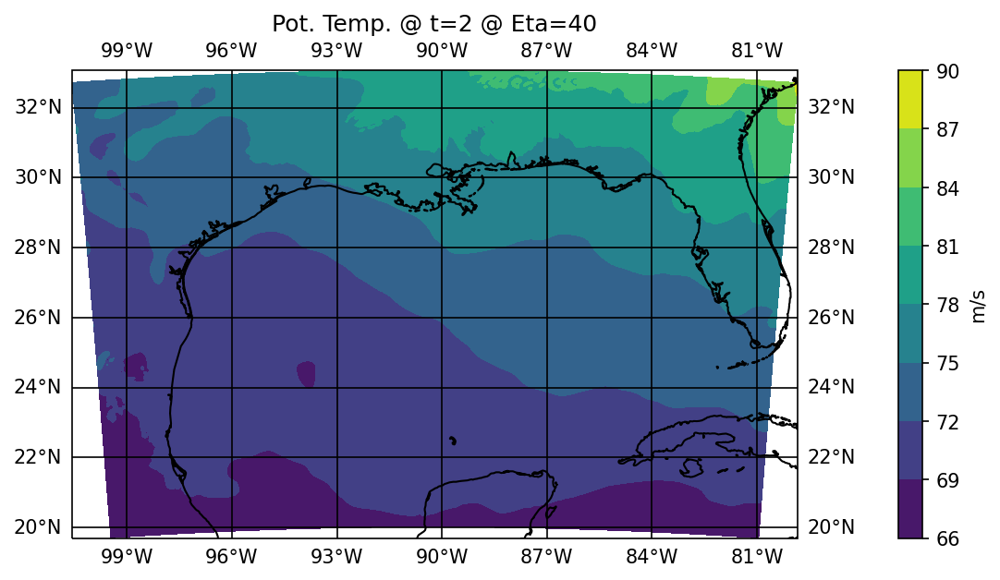

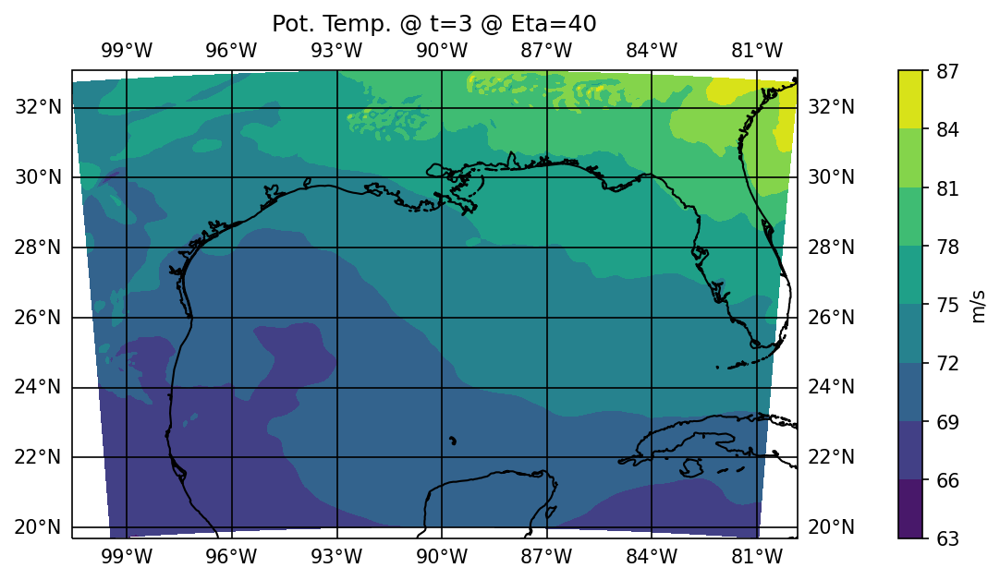

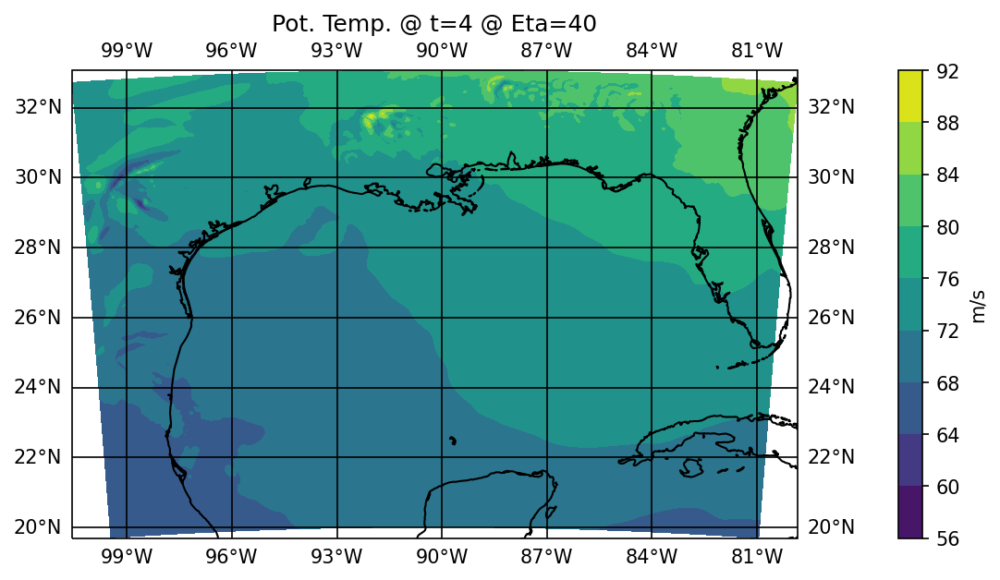

...

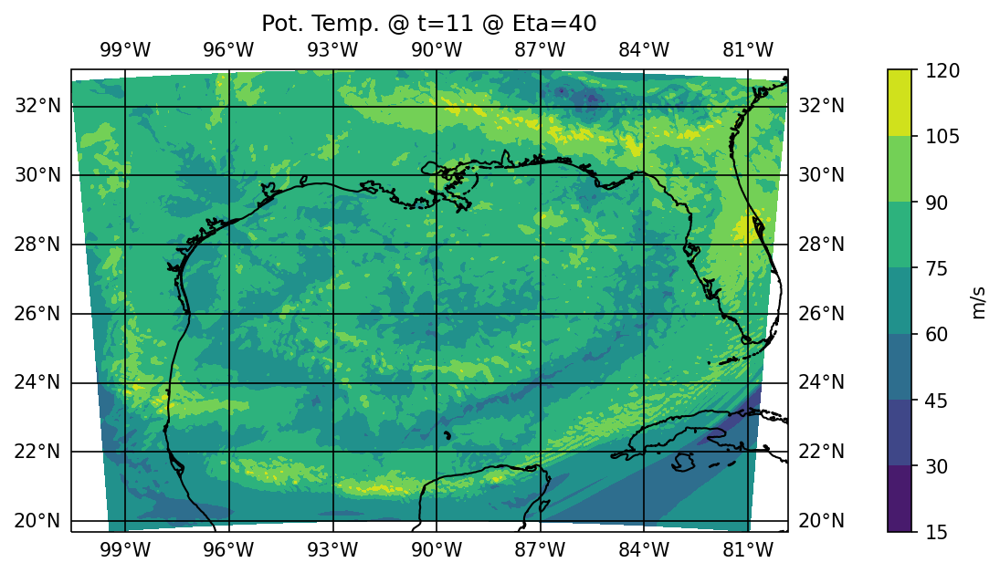

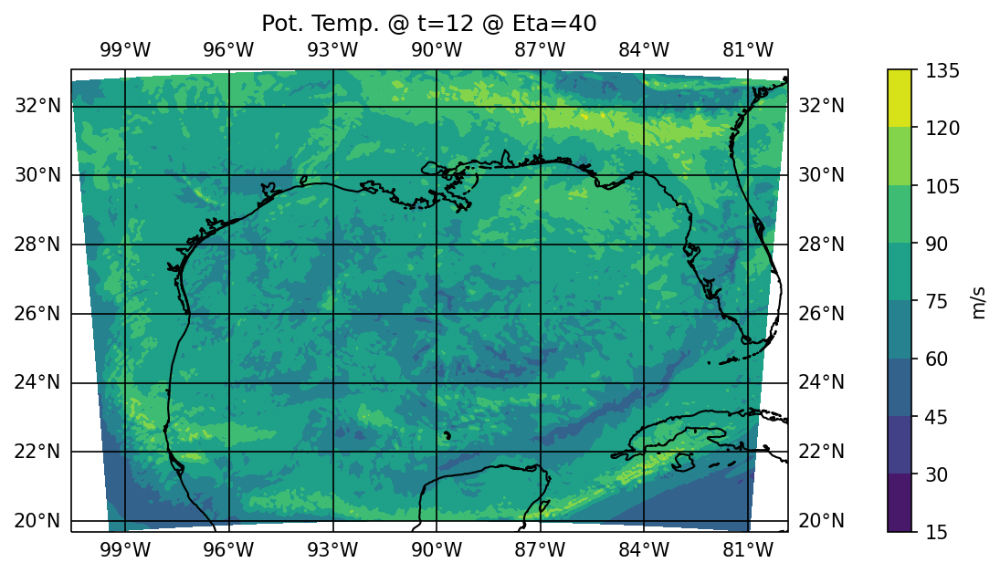

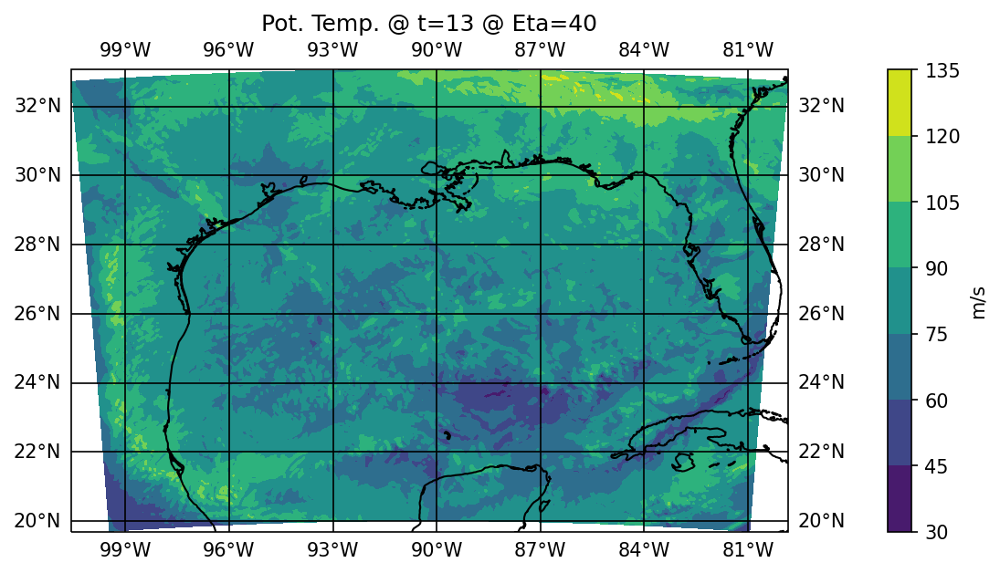

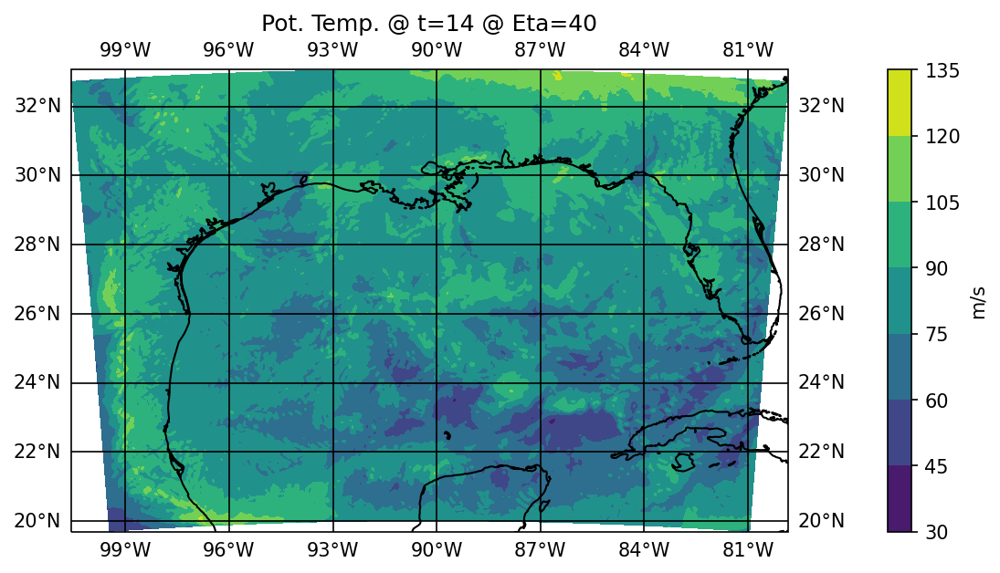

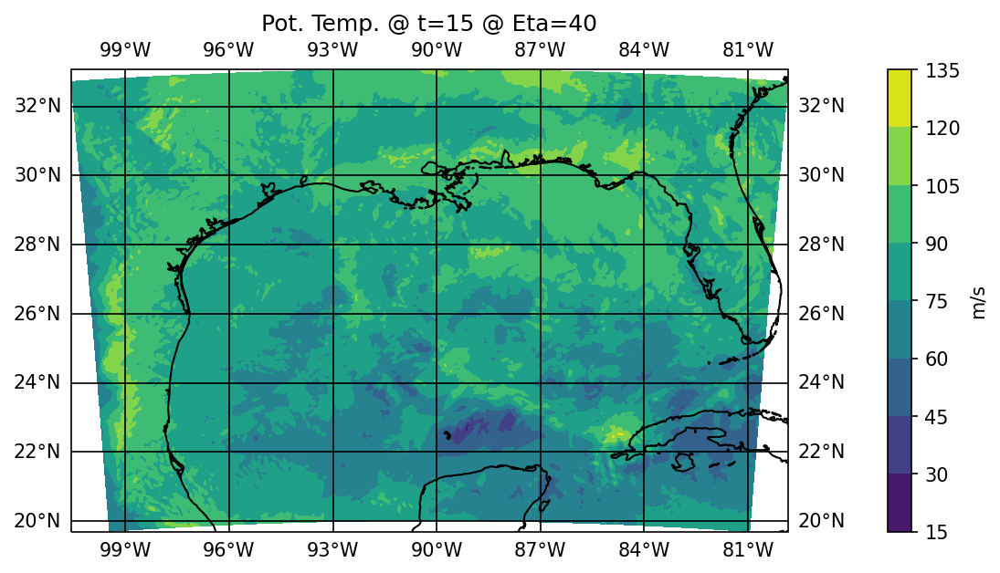

In [7]:
#Eta40
mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], poT_0[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=0 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], poT_1[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=1 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], poT_2[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=2 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], poT_3[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=3 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], poT_4[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=4 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], poT_5[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=5 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], poT_6[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=6 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], poT_7[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=7 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], poT_8[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=8 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], poT_9[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=9 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], poT_10[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.@ t=10 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta10_time40.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], poT_11[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=11 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], poT_12[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=12 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], poT_13[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=13 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], poT_14[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=14 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], poT_15[0,40,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=15 @ Eta=40')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta40_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()

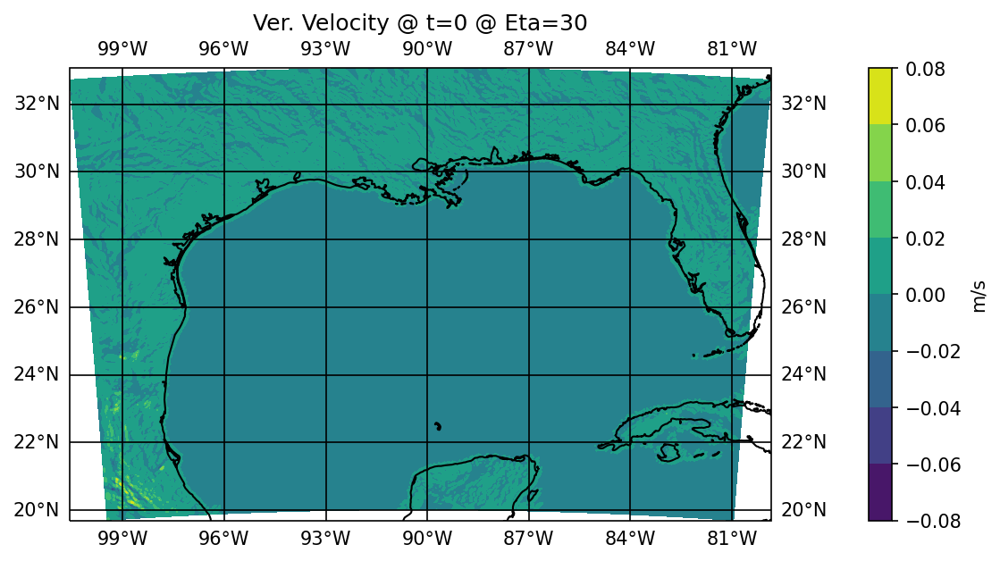

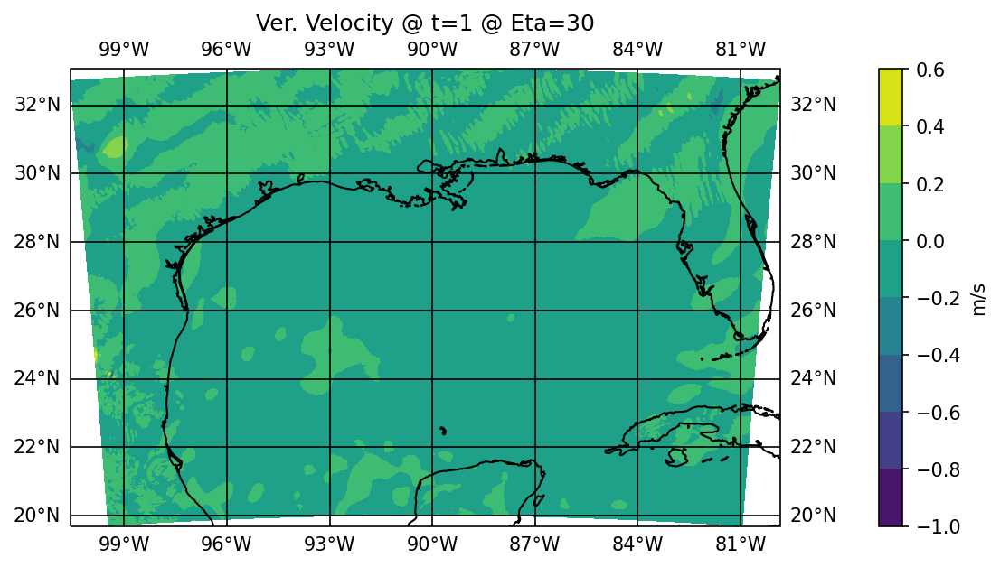

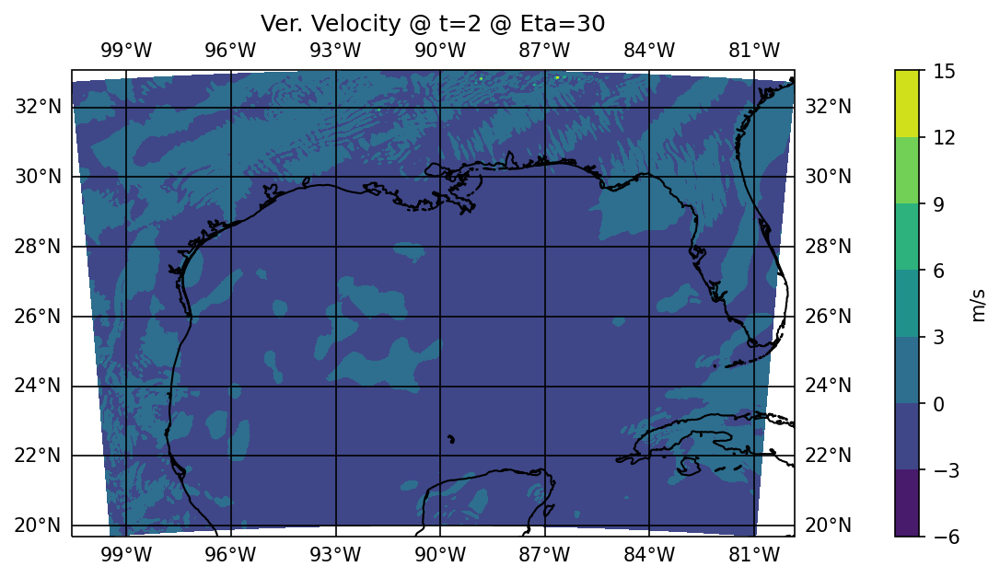

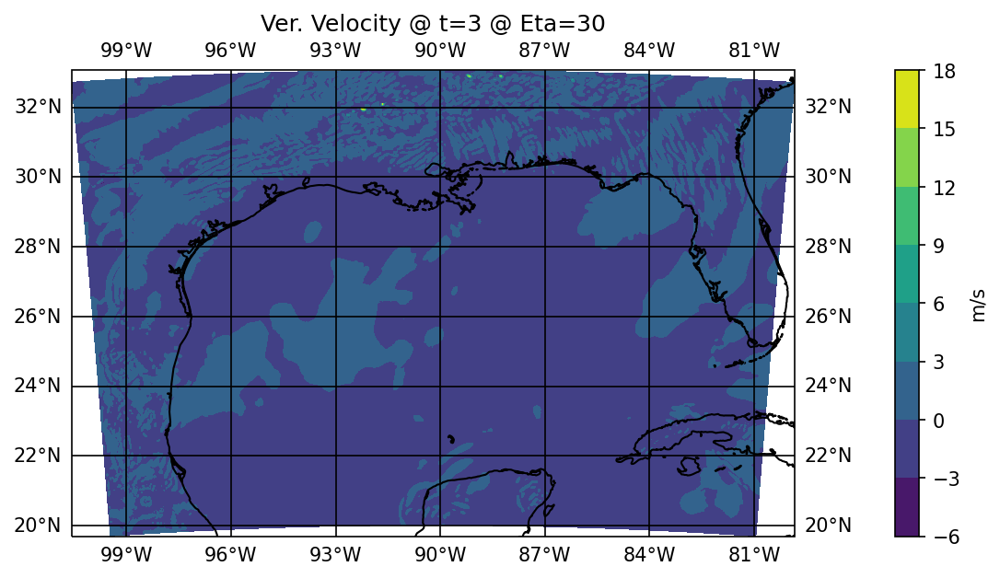

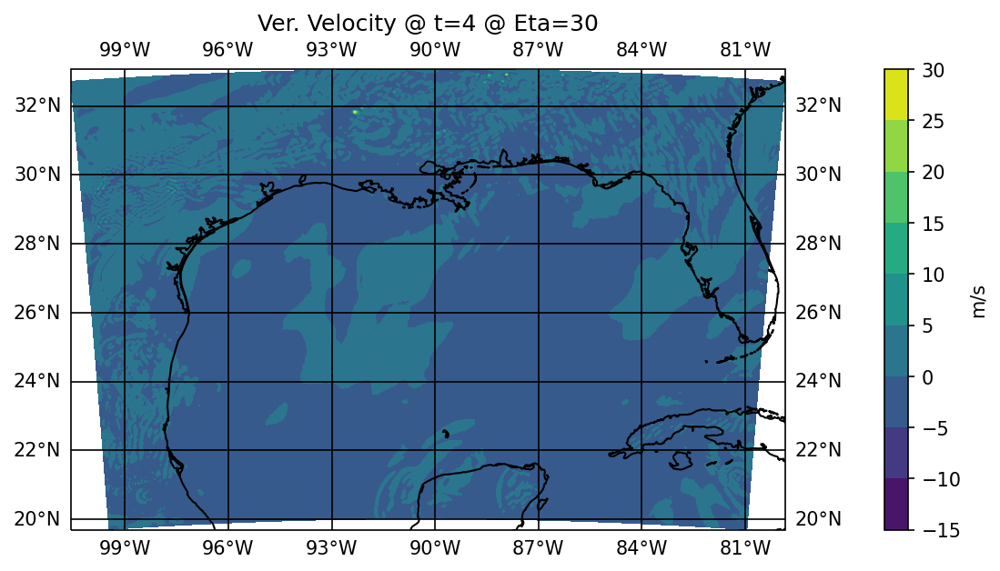

...

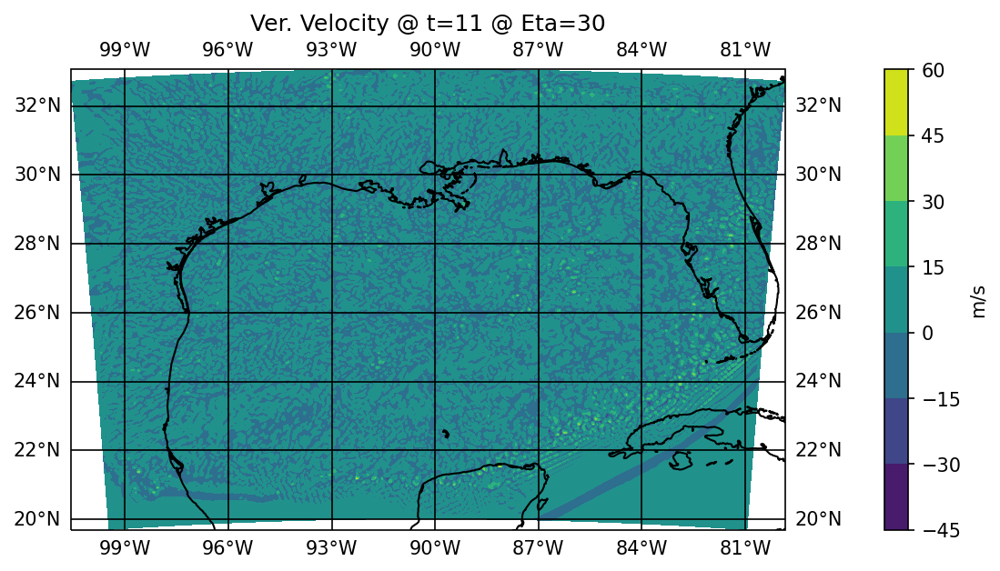

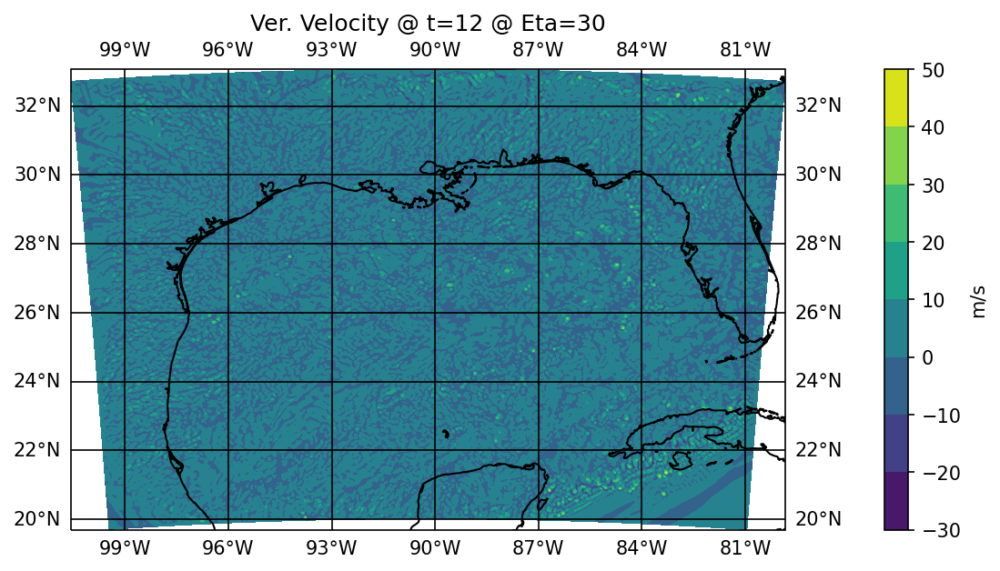

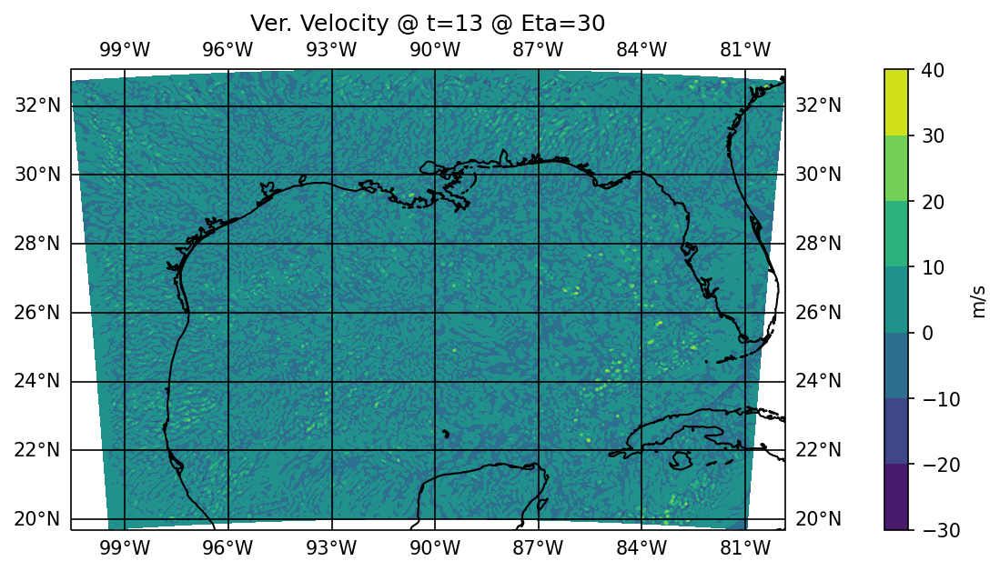

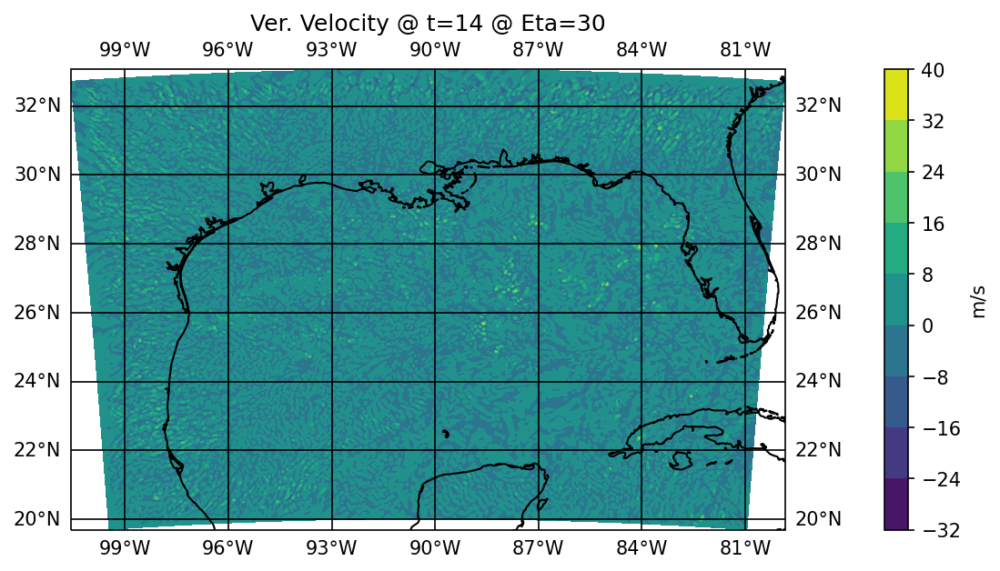

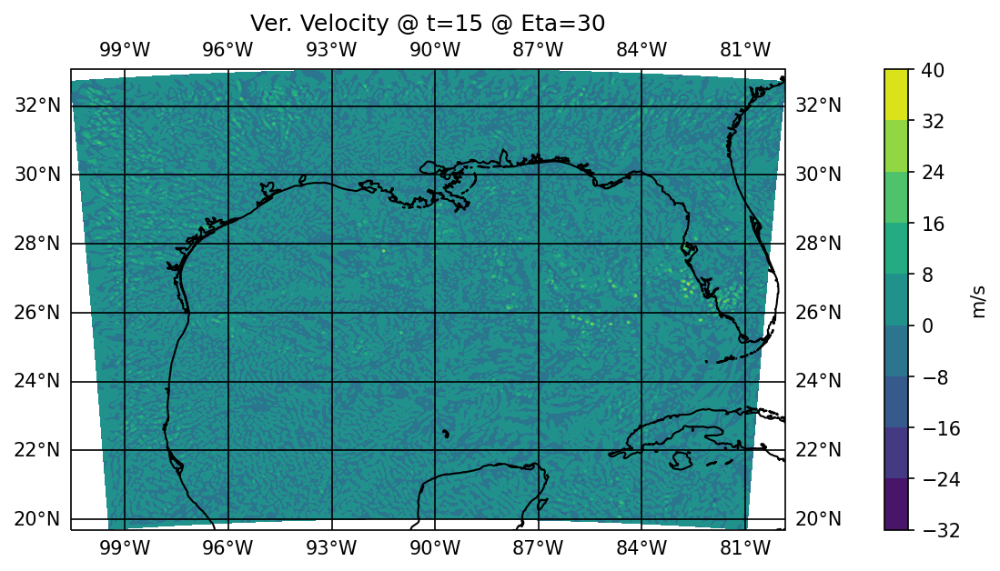

In [11]:
#Eta30

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], w_0[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=0 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], w_1[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=1 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], w_2[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=2 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], w_3[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=3 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], w_4[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=4 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], w_5[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=5 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], w_6[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=6 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], w_7[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=7 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], w_8[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=8 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], w_9[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=9 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], w_10[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=10 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time20.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], w_11[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=11 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], w_12[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=12 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], w_13[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=13 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], w_14[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=14 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], w_15[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ver. Velocity @ t=15 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'eta30_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()


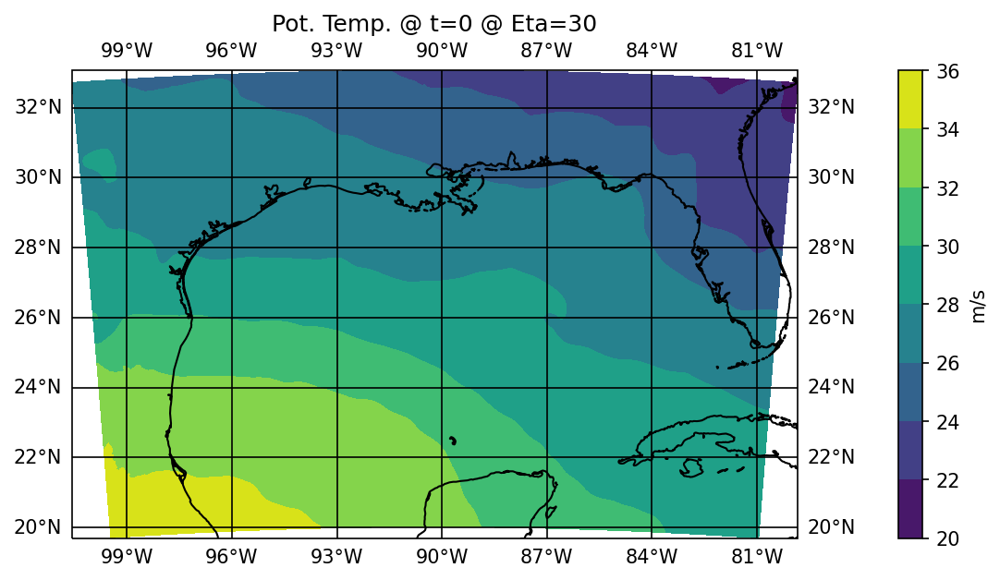

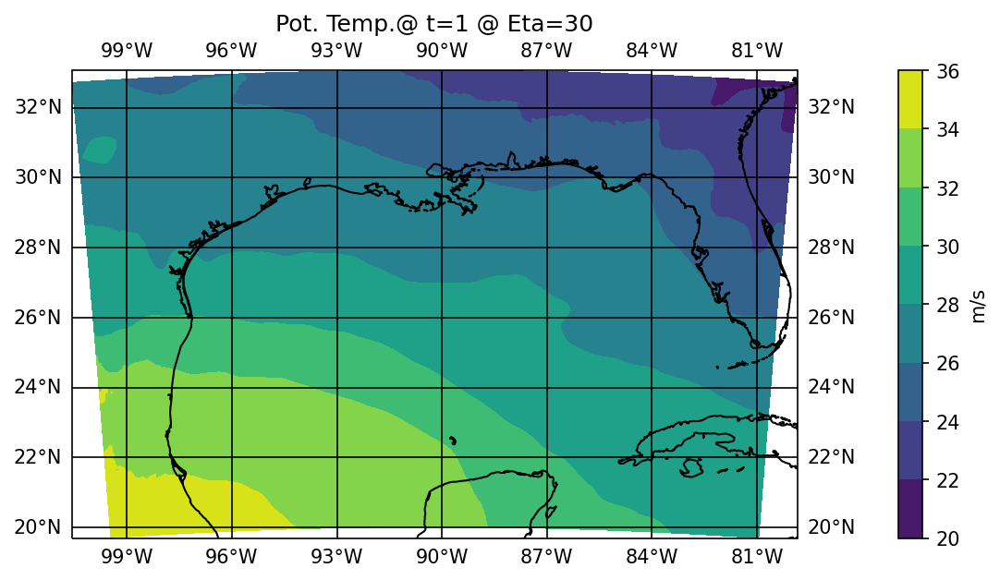

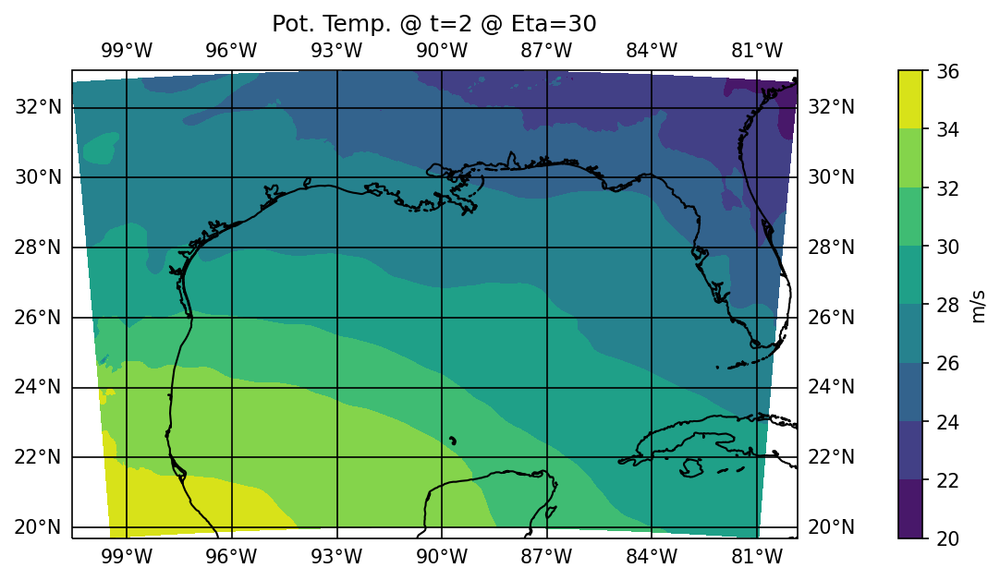

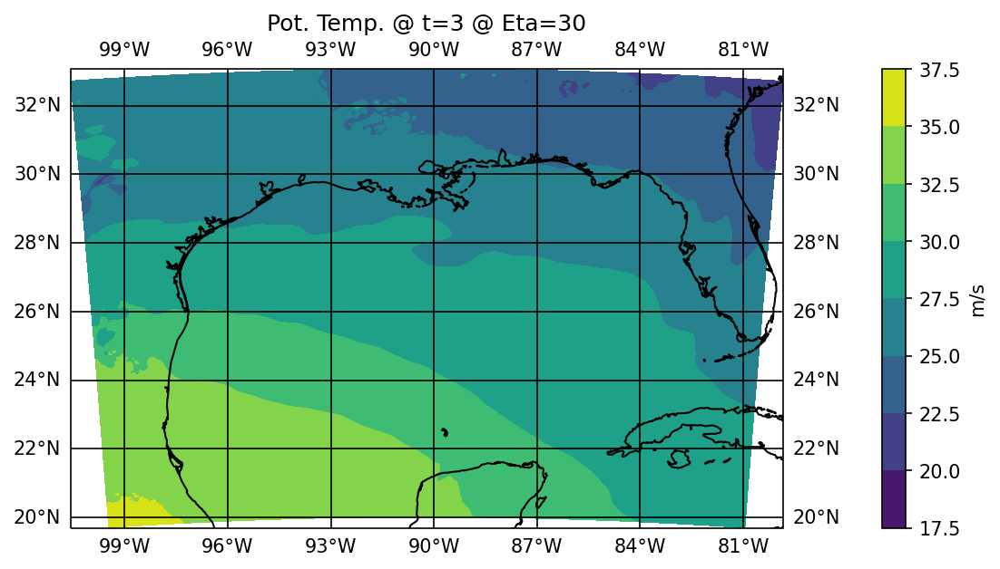

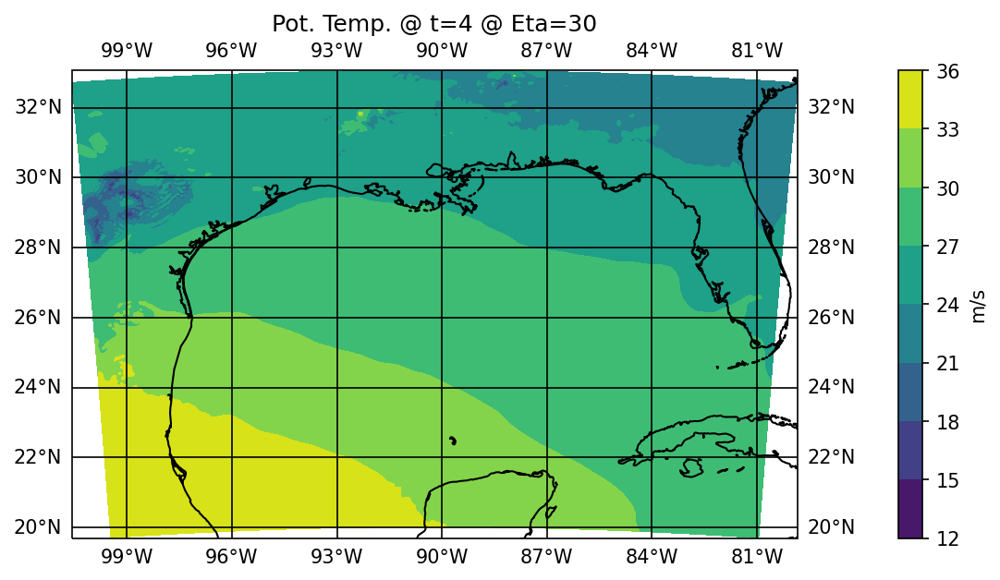

...

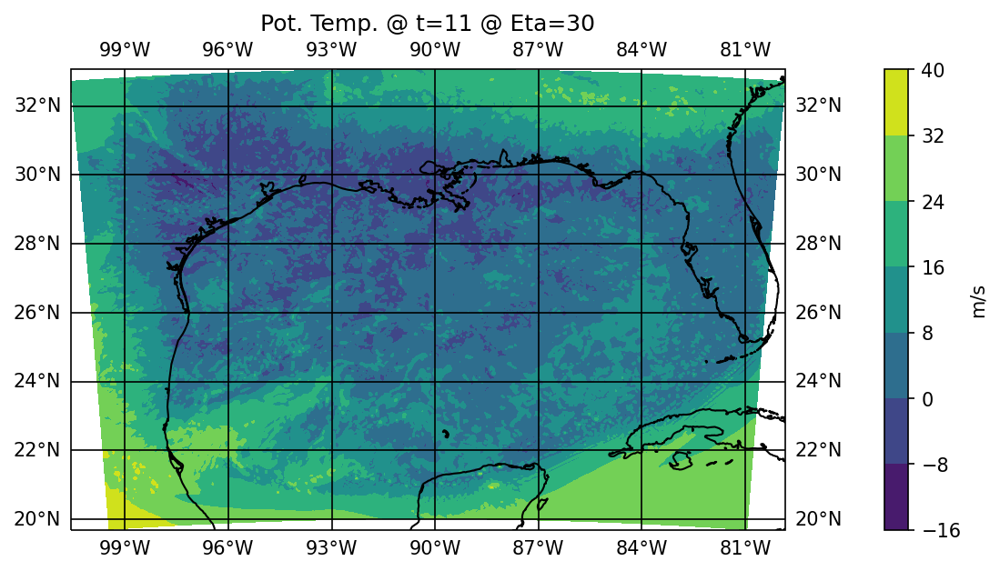

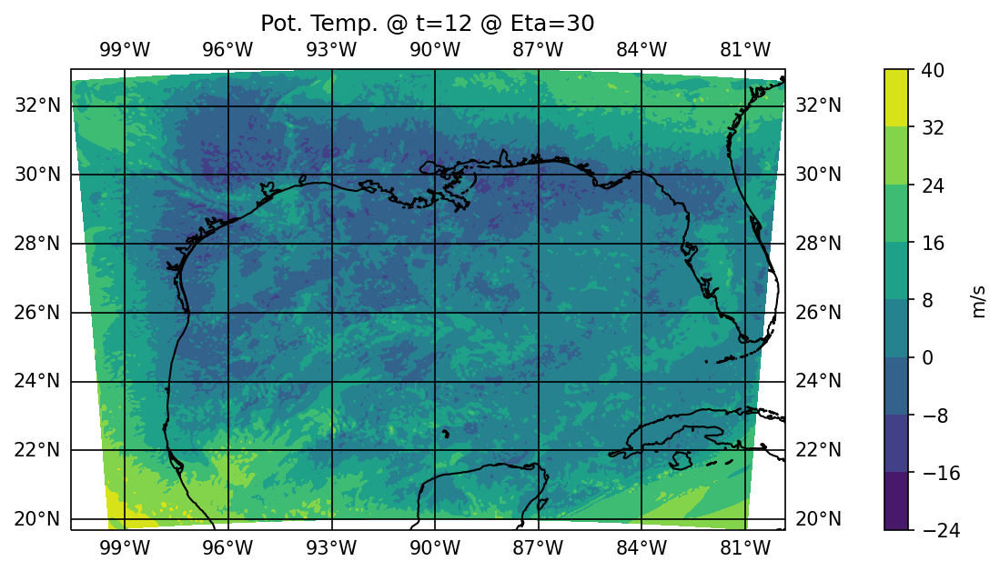

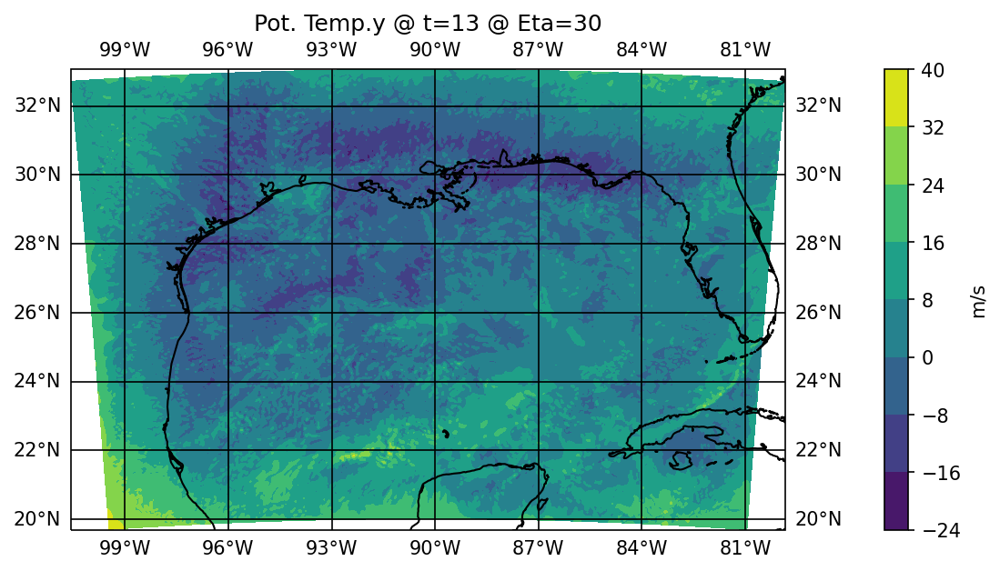

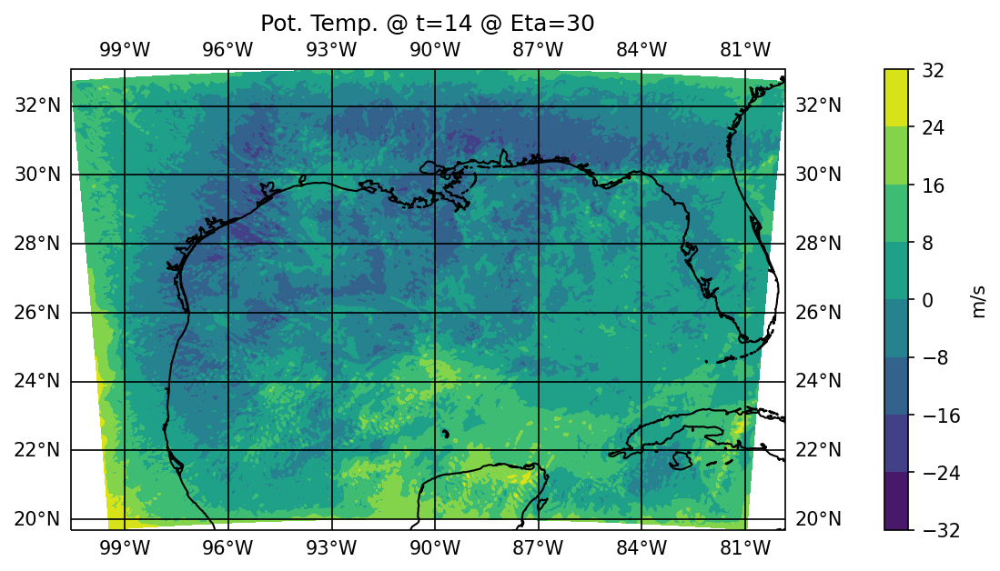

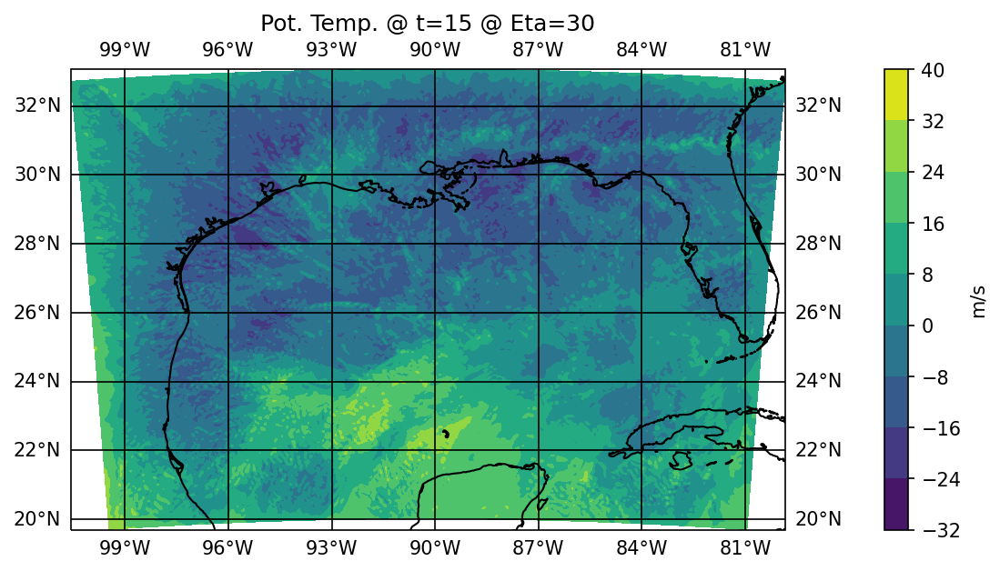

In [8]:
#Eta30

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon0[0,:,:], lat0[0,:,:], poT_0[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=0 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time0.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon1[0,:,:], lat1[0,:,:], poT_1[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.@ t=1 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time1.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon2[0,:,:], lat2[0,:,:], poT_2[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=2 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time2.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon3[0,:,:], lat3[0,:,:], poT_3[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=3 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time3.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon4[0,:,:], lat4[0,:,:], poT_4[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=4 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time4.png', bbox_inches = 'tight',dpi = 150)
plt.show()


mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon5[0,:,:], lat5[0,:,:], poT_5[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=5 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time5.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon6[0,:,:], lat6[0,:,:], poT_6[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=6 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time6.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon7[0,:,:], lat7[0,:,:], poT_7[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=7 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time7.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon8[0,:,:], lat8[0,:,:], poT_8[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=8 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time8.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon9[0,:,:], lat9[0,:,:], poT_9[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=9 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time9.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon10[0,:,:], lat10[0,:,:], poT_10[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=10 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time20.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon11[0,:,:], lat11[0,:,:], poT_11[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=11 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time11.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon12[0,:,:], lat12[0,:,:], poT_12[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=12 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time12.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon13[0,:,:], lat13[0,:,:], poT_13[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp.y @ t=13 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time13.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon14[0,:,:], lat14[0,:,:], poT_14[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=14 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time14.png', bbox_inches = 'tight',dpi = 150)
plt.show()

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 4), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
ax.coastlines()
cs = ax.contourf(lon15[0,:,:], lat15[0,:,:], poT_15[0,30,:,:])
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, pad = 0.1, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Pot. Temp. @ t=15 @ Eta=30')
save_results_to = '/Users/Anna/Desktop/WRF/D2_D1_Only/'
plt.savefig(save_results_to + 'PoT_eta30_time15.png', bbox_inches = 'tight',dpi = 150)
plt.show()
